# **A Data Analysis of The New York City Taxi and Limousine Commision Trip Record**

<hr>

# **1. Introduction**

**The New York City Taxi and Limousine Commision (TLC)** is the agency responsible for licensing and regulating New York City's Medallion (Yellow) taxi cabs, for-hire vehicles (community-based liveries, black cars and luxury limousines), commuter vans, and paratransit vehicles ([NYC TLC Official Website](https://www.nyc.gov/site/tlc/about/about-tlc.page)). With a lot of daily trips, the agency would like to know what exactly are they doing and how are they doing. This is key to improve both service quality and revenue. 

## **Business Problem**


With a significant volume of daily trips, TLC aims to further **understand its operations to improve service quality & availability and revenue**. Without actionable insights gathered from the data, inefficiencies in armada usage and demand fulfillment may occur, decreasing customer satisfaction and thus, profitability.

By analyzing this data, TLC hopes to answer business critical questions such as **peak hours**, **high-demand locations**, and **average trip revenue generation**. These insights will allow the agency and us (as the data analyst) to **optimize resource allocation**, **improve service quality**, and perhaps **adjust pricing strategies** to better suit the market conditions.

As a Data Analyst, we aim to answer these questions:
1. What is the trip pattern like?
2. Which areas has a lot of attention? and which area needs attention?
3. How does our passengers behave?
4. How are fare and tips generated?
5. What makes up our revenue?

<hr>

# **2. Data Preparation**

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import folium

import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', None) # display all columns, without limits

In [2]:
df = pd.read_csv("NYC TLC Trip Record.csv")
df

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2,2023-01-01 00:26:10,2023-01-01 00:37:11,N,1.0,166,143,1.0,2.58,14.90,1.0,0.5,4.03,0.0,NaN,1.0,24.18,1.0,1.0,2.75
1,2,2023-01-01 00:51:03,2023-01-01 00:57:49,N,1.0,24,43,1.0,1.81,10.70,1.0,0.5,2.64,0.0,NaN,1.0,15.84,1.0,1.0,0.00
2,2,2023-01-01 00:35:12,2023-01-01 00:41:32,N,1.0,223,179,1.0,0.00,7.20,1.0,0.5,1.94,0.0,NaN,1.0,11.64,1.0,1.0,0.00
3,1,2023-01-01 00:13:14,2023-01-01 00:19:03,N,1.0,41,238,1.0,1.30,6.50,0.5,1.5,1.70,0.0,NaN,1.0,10.20,1.0,1.0,0.00
4,1,2023-01-01 00:33:04,2023-01-01 00:39:02,N,1.0,41,74,1.0,1.10,6.00,0.5,1.5,0.00,0.0,NaN,1.0,8.00,1.0,1.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68206,2,2023-01-31 22:29:00,2023-01-31 22:42:00,NaN,NaN,49,62,NaN,4070.82,15.70,0.0,0.0,0.00,0.0,NaN,1.0,16.70,NaN,NaN,NaN
68207,2,2023-01-31 22:40:00,2023-01-31 22:48:00,NaN,NaN,10,205,NaN,2.14,4.41,0.0,0.0,0.00,0.0,NaN,1.0,5.41,NaN,NaN,NaN
68208,2,2023-01-31 23:46:00,2023-02-01 00:02:00,NaN,NaN,66,37,NaN,3.44,16.53,0.0,0.0,3.51,0.0,NaN,1.0,21.04,NaN,NaN,NaN
68209,2,2023-01-31 23:01:00,2023-01-31 23:19:00,NaN,NaN,225,189,NaN,3.03,14.98,0.0,0.0,3.20,0.0,NaN,1.0,19.18,NaN,NaN,NaN


The dataset provided by the agency is a **record of trips** in the **New York City** area. In order to further analize this data, we will have to first understand and clean the data.
   

## **Data Understanding & Cleaning**

Included within this dataset is 20 columns, which are:

| **Feature**               | **Description**                                                                                                         | **Values**                                                                                          |
|----------------------------|-------------------------------------------------------------------------------------------------------------------------|-----------------------------------------------------------------------------------------------------|
| **VendorID**              | A code indicating the LPEP provider that provided the record.                                                           | `1` = Creative Mobile Technologies, LLC<br>`2` = VeriFone Inc.                                     |
| **lpep_pickup_datetime**  | The date and time when the meter was engaged.                                                                           | -                                                                                                   |
| **lpep_dropoff_datetime** | The date and time when the meter was disengaged.                                                                        | -                                                                                                   |
| **passenger_count**       | The number of passengers in the vehicle. This is a driver-entered value.                                               | -                                                                                                   |
| **trip_distance**         | The elapsed trip distance in miles, as reported by the taximeter.                                                      | -                                                                                                   |
| **PULocationID**          | TLC Taxi Zone in which the taximeter was engaged.                                                                       | -                                                                                                   |
| **DOLocationID**          | TLC Taxi Zone in which the taximeter was disengaged.                                                                    | -                                                                                                   |
| **RateCodeID**            | The final rate code in effect at the end of the trip.                                                                   | `1` = Standard rate<br>`2` = JFK<br>`3` = Newark<br>`4` = Nassau or Westchester<br>`5` = Negotiated fare<br>`6` = Group ride |
| **store_and_fwd_flag**    | Indicates whether the trip record was held in the vehicle memory before sending to the vendor.                          | `Y` = Store and forward trip<br>`N` = Not a store and forward trip                                  |
| **payment_type**          | A numeric code signifying how the passenger paid for the trip.                                                         | `1` = Credit card<br>`2` = Cash<br>`3` = No charge<br>`4` = Dispute<br>`5` = Unknown<br>`6` = Voided trip |
| **fare_amount**           | The time-and-distance fare calculated by the meter.                                                                    | -                                                                                                   |
| **extra**                 | Miscellaneous extras and surcharges, including $0.50 and $1 rush hour and overnight charges.                           | -                                                                                                   |
| **mta_tax**               | $0.50 MTA tax that is automatically triggered based on the metered rate in use.                                         | -                                                                                                   |
| **improvement_surcharge** | $0.30 improvement surcharge assessed on hailed trips at the flag drop. Began being levied in 2015.                      | -                                                                                                   |
| **congestion_surcharge** | A surcharge included should the trip encounter a certain amount of congestion.                      | -                                                                                                   |
| **tip_amount**            | Automatically populated for credit card tips. Cash tips are not included.                                              | -                                                                                                   |
| **tolls_amount**          | The total amount of all tolls paid in the trip.                                                                         | -                                                                                                   |
| **total_amount**          | The total amount charged to passengers. Does not include cash tips.                                                    | -                                                                                                   |
| **trip_type**             | A code indicating whether the trip was a street hail or a dispatch. Assigned based on the metered rate but alterable.  | `1` = Street-hail<br>`2` = Dispatch    


In this step we are to examine the data so that we fully understand the **raw-data**. This step is very crucial to make sure we have a workable data. In this chapter, we will not only analyze the data but also take **immediate cleaning actions** where necessary. For each action, we will include a **justification**, which may be informed by **domain knowledge** or guided by **basic statistical principles**.

### **Function Library**

This is here to simplify futher code that requires repetitive codes.

In [3]:
def viewNaNRows():
  missing_data_df = pd.DataFrame({
    'Missing Values Count': df.isna().sum(),
    'Missing Values Percentage': df.isna().sum()/df.shape[0]*100
  })

  missing_data_df.index.set_names('Columns', inplace=True)

  # Value Formatting
  missing_data_df['Missing Values Count'] = missing_data_df['Missing Values Count'].apply(lambda x: f'{x:,}')
  missing_data_df['Missing Values Percentage'] = missing_data_df['Missing Values Percentage'].apply(lambda x: f'{x:.2f} %')

  return missing_data_df[missing_data_df['Missing Values Count'] != '0'].sort_values('Missing Values Count', ascending=False)

In [4]:
def pltFigsize(size: tuple):
  plt.figure(figsize=size)

In [5]:
def pltTitle(title: str):
  plt.title(
    title,
    fontdict={
      'fontsize': 16,
      'fontweight' : 'bold',
    }
  )

In [6]:
def showBoxPlot(source, col_x: str, x_axis_label: str):
  sns.boxplot(source, x=col_x)

  pltTitle(f"Distribution of {x_axis_label}")

  plt.xlabel(x_axis_label)

In [7]:
def showHistplot(source, col_x: str, x_axis_label: str):
  sns.histplot(source, x=col_x, kde=True)

  pltTitle(f"Frequency Distribution of {x_axis_label}")

  plt.xlabel(x_axis_label)

In [8]:
def showDistributionCombo(source, col_x: str, x_axis_label: str):
  plt.figure(figsize=(20,5))

  plt.subplot(1,2,1)
  showBoxPlot(source,  col_x, x_axis_label)

  plt.subplot(1,2,2)
  showHistplot(source,  col_x, x_axis_label)

  plt.show()

In [9]:
def showBarNumbers(currency_symbol: str, decimal=0):
  for patch in plt.gca().patches:
    value = round(patch.get_height(), decimal)

    s = f"{value:,}"

    if currency_symbol != "":
      s = f"{currency_symbol}{s}"

    plt.text(
      x=patch.get_x() + patch.get_width()/2,
      y=patch.get_height(),
      s=s,
      ha='center',
      va='bottom',
      fontsize=9,
    )

In [10]:
def showBarPlot(data, x_col: str, y_col: str, title: str, x_label: str, y_label: str, order, currency_symbol="", decimal=0):
  sns.barplot(
    data=data,
    x=x_col,
    y=y_col,
    palette='muted',
    order=order
  )

  pltTitle(title)

  showBarNumbers(currency_symbol, decimal)

  plt.xlabel(x_label)
  plt.ylabel(y_label)

  plt.tight_layout()

In [11]:
def timeOfDayGroupper(x):
  if x >= 0 and x < 5:
    return 'Early Morning'
  elif x >= 5 and x < 9:
    return 'Morning'
  elif x >= 9 and x < 12:
    return 'Late Morning'
  elif x >= 12 and x < 16:
    return 'Afternoon'
  elif x >= 16 and x < 20:
    return 'Evening'
  else:
    return 'Nighttime'

In [12]:
def dayNameListOrder():
  return ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

In [13]:
def timeOfDayGroupListOrder():
  return ['Early Morning', 'Morning', 'Late Morning', 'Afternoon', 'Evening', 'Nighttime']

In [14]:
center_coordinates_library = {
  1: {'coords': [40.691831206401325, -74.17400027276304], 'zone': 'Newark Airport'},
  2: {'coords': [40.61674529165957, -73.83129854302213], 'zone': 'Jamaica Bay'},
  3: {'coords': [40.86447368477527, -73.84742223236718], 'zone': 'Allerton/Pelham Gardens'},
  4: {'coords': [40.72375214158459, -73.97696825691759], 'zone': 'Alphabet City'},
  5: {'coords': [40.55265928694546, -74.18848410184935], 'zone': 'Arden Heights'},
  6: {'coords': [40.600324146034424, -74.07177055895134], 'zone': 'Arrochar/Fort Wadsworth'},
  7: {'coords': [40.7614925621636, -73.91969431946075], 'zone': 'Astoria'},
  8: {'coords': [40.778558653750515, -73.9230861575075], 'zone': 'Astoria Park'},
  9: {'coords': [40.75103502557218, -73.7879488777789], 'zone': 'Auburndale'},
  24: {'coords': [40.801970493899425, -73.96547951516966], 'zone': 'Bloomingdale'},
  10: {'coords': [40.678953310115105, -73.79098635986959], 'zone': 'Baisley Park'},
  11: {'coords': [40.60427284003062, -74.00748815801177], 'zone': 'Bath Beach'},
  12: {'coords': [40.70294583498452, -74.01556351255894], 'zone': 'Battery Park'},
  13: {'coords': [40.71203815707432, -74.01607915192938], 'zone': 'Battery Park City'},
  18: {'coords': [40.86768245607527, -73.89018328872038], 'zone': 'Bedford Park'},
  25: {'coords': [40.68563374132041, -73.98611382213656], 'zone': 'Boerum Hill'},
  14: {'coords': [40.62483492360799, -74.02989237418787], 'zone': 'Bay Ridge'},
  15: {'coords': [40.783333047260825, -73.78597227877704], 'zone': 'Bay Terrace/Fort Totten'},
  22: {'coords': [40.61221825780545, -73.99525857986232], 'zone': 'Bensonhurst West'},
  23: {'coords': [40.60644770102735, -74.17088688155253], 'zone': 'Bloomfield/Emerson Hill'},
  16: {'coords': [40.762738375442225, -73.77342181890143], 'zone': 'Bayside'},
  17: {'coords': [40.69150749488049, -73.9499050350751], 'zone': 'Bedford'},
  19: {'coords': [40.73548677976318, -73.72665537528698], 'zone': 'Bellerose'},
  20: {'coords': [40.85777967544136, -73.88586748106964], 'zone': 'Belmont'},
  21: {'coords': [40.60142943983495, -73.98353709672229], 'zone': 'Bensonhurst East'},
  26: {'coords': [40.63094965524526, -73.98866123078287], 'zone': 'Borough Park'},
  27: {'coords': [40.5591332794673, -73.90690832237571], 'zone': 'Breezy Point/Fort Tilden/Riis Beach'},
  28: {'coords': [40.71159635794484, -73.80872901637508], 'zone': 'Briarwood/Jamaica Hills'},
  33: {'coords': [40.695798221211106, -73.99525011996629], 'zone': 'Brooklyn Heights'},
  29: {'coords': [40.580921971933584, -73.96121676866845], 'zone': 'Brighton Beach'},
  31: {'coords': [40.85774668091573, -73.87547595053037], 'zone': 'Bronx Park'},
  32: {'coords': [40.86400220602343, -73.86490099876723], 'zone': 'Bronxdale'},
  30: {'coords': [40.603687442135325, -73.82192695679392], 'zone': 'Broad Channel'},
  34: {'coords': [40.70085573851691, -73.97118869233043], 'zone': 'Brooklyn Navy Yard'},
  35: {'coords': [40.664003117925766, -73.91025783136135], 'zone': 'Brownsville'},
  36: {'coords': [40.700522199519, -73.91771053131578], 'zone': 'Bushwick North'},
  37: {'coords': [40.69499431844193, -73.92224002165723], 'zone': 'Bushwick South'},
  38: {'coords': [40.69434146723156, -73.73555427058828], 'zone': 'Cambria Heights'},
  39: {'coords': [40.63803713911685, -73.89973495669389], 'zone': 'Canarsie'},
  40: {'coords': [40.6791990140969, -73.99595619089156], 'zone': 'Carroll Gardens'},
  41: {'coords': [40.80433394979442, -73.95129200243512], 'zone': 'Central Harlem'},
  45: {'coords': [40.71245931177932, -73.99815149899052], 'zone': 'Chinatown'},
  46: {'coords': [40.84908594313943, -73.78198714613215], 'zone': 'City Island'},
  42: {'coords': [40.818257861119044, -73.94077166756259], 'zone': 'Central Harlem North'},
  43: {'coords': [40.78247809974769, -73.96555356545908], 'zone': 'Central Park'},
  44: {'coords': [40.525494581763574, -74.23353354937646], 'zone': 'Charleston/Tottenville'},
  47: {'coords': [40.842749176097854, -73.90031590586496], 'zone': 'Claremont/Bathgate'},
  48: {'coords': [40.76225275531919, -73.989844643133], 'zone': 'Clinton East'},
  49: {'coords': [40.687967457147245, -73.96236353818352], 'zone': 'Clinton Hill'},
  50: {'coords': [40.766237725041655, -73.9951352207551], 'zone': 'Clinton West'},
  51: {'coords': [40.873973054920086, -73.82826367307182], 'zone': 'Co-Op City'},
  52: {'coords': [40.68665124165588, -73.99672403175194], 'zone': 'Cobble Hill'},
  53: {'coords': [40.780912355790896, -73.84281349543171], 'zone': 'College Point'},
  54: {'coords': [40.68720074733709, -74.00291127745284], 'zone': 'Columbia Street'},
  55: {'coords': [40.576960753637564, -73.98794343407188], 'zone': 'Coney Island'},
  56: {'coords': [40.751819366999264, -73.85358156034263], 'zone': 'Corona'},
  58: {'coords': [40.84145210068231, -73.82039319252782], 'zone': 'Country Club'},
  59: {'coords': [40.83855028852771, -73.89498588493974], 'zone': 'Crotona Park'},
  60: {'coords': [40.83399047727372, -73.88590003419164], 'zone': 'Crotona Park East'},
  61: {'coords': [40.67446941826625, -73.93928705867955], 'zone': 'Crown Heights North'},
  62: {'coords': [40.666540405785405, -73.94878853931498], 'zone': 'Crown Heights South'},
  63: {'coords': [40.68383976195084, -73.87817261050249], 'zone': 'Cypress Hills'},
  64: {'coords': [40.76061560532138, -73.7393371499285], 'zone': 'Douglaston'},
  65: {'coords': [40.695337529460986, -73.98608600498395], 'zone': 'Downtown Brooklyn/MetroTech'},
  72: {'coords': [40.65236480407718, -73.92225097400487], 'zone': 'East Flatbush/Remsen Village'},
  66: {'coords': [40.7022589388223, -73.98570161582278], 'zone': 'DUMBO/Vinegar Hill'},
  67: {'coords': [40.619619467834944, -74.01380148744013], 'zone': 'Dyker Heights'},
  68: {'coords': [40.74842755506554, -73.99991742024714], 'zone': 'East Chelsea'},
  73: {'coords': [40.75410888689277, -73.80729418212232], 'zone': 'East Flushing'},
  69: {'coords': [40.83141669708498, -73.91502929553266], 'zone': 'East Concourse/Concourse Village'},
  70: {'coords': [40.763352201132975, -73.86839559842015], 'zone': 'East Elmhurst'},
  71: {'coords': [40.64428817438895, -73.93796627061685], 'zone': 'East Flatbush/Farragut'},
  79: {'coords': [40.72762019590936, -73.98593745682464], 'zone': 'East Village'},
  80: {'coords': [40.715369882143314, -73.93679314491878], 'zone': 'East Williamsburg'},
  74: {'coords': [40.801169480586296, -73.93734560812489], 'zone': 'East Harlem North'},
  85: {'coords': [40.64611634689489, -73.95162318261008], 'zone': 'Erasmus'},
  86: {'coords': [40.60243279341622, -73.75524369679556], 'zone': 'Far Rockaway'},
  75: {'coords': [40.7900107514952, -73.94575026755157], 'zone': 'East Harlem South'},
  76: {'coords': [40.660935196550405, -73.87682061127202], 'zone': 'East New York'},
  77: {'coords': [40.66655893903507, -73.89536411750329], 'zone': 'East New York/Pennsylvania Avenue'},
  78: {'coords': [40.84496041014594, -73.88552181587433], 'zone': 'East Tremont'},
  81: {'coords': [40.88093541148925, -73.83664334408299], 'zone': 'Eastchester'},
  87: {'coords': [40.706808451665665, -74.00749598562426], 'zone': 'Financial District North'},
  82: {'coords': [40.73949564677802, -73.87711833280919], 'zone': 'Elmhurst'},
  83: {'coords': [40.73832381382578, -73.89217338112863], 'zone': 'Elmhurst/Maspeth'},
  84: {'coords': [40.52868644656603, -74.18767433468827], 'zone': "Eltingville/Annadale/Prince's Bay"},
  88: {'coords': [40.703357903235975, -74.01151502922316], 'zone': 'Financial District South'},
  89: {'coords': [40.637900123473564, -73.96096824906373], 'zone': 'Flatbush/Ditmas Park'},
  90: {'coords': [40.74227862901209, -73.99697141558367], 'zone': 'Flatiron'},
  125: {'coords': [40.726290410281024, -74.00748581800949], 'zone': 'Hudson Sq'},
  91: {'coords': [40.626272763336225, -73.93009701219937], 'zone': 'Flatlands'},
  92: {'coords': [40.761102189834205, -73.82885869884264], 'zone': 'Flushing'},
  93: {'coords': [40.740675872160516, -73.84086726234158], 'zone': 'Flushing Meadows-Corona Park'},
  94: {'coords': [40.85815519618384, -73.89953593442144], 'zone': 'Fordham South'},
  95: {'coords': [40.721432275021115, -73.84766941187522], 'zone': 'Forest Hills'},
  96: {'coords': [40.697000613100926, -73.87155842518146], 'zone': 'Forest Park/Highland Park'},
  97: {'coords': [40.69078679421068, -73.97488208618893], 'zone': 'Fort Greene'},
  98: {'coords': [40.73446262820073, -73.77725346665986], 'zone': 'Fresh Meadows'},
  99: {'coords': [40.576773635486845, -74.18641851305911], 'zone': 'Freshkills Park'},
  100: {'coords': [40.75351275872555, -73.98878659911529], 'zone': 'Garment District'},
  101: {'coords': [40.74599381838399, -73.71102598691229], 'zone': 'Glen Oaks'},
  102: {'coords': [40.70354561076272, -73.87573576709777], 'zone': 'Glendale'},
  103: {'coords': [40.68878423861278, -74.01907272636822], 'zone': "Governor's Island/Ellis Island/Liberty Island"},
  106: {'coords': [40.67351279686057, -73.99064727363117], 'zone': 'Gowanus'},
  107: {'coords': [40.73682405761877, -73.98405213268907], 'zone': 'Gramercy'},
  108: {'coords': [40.58840346529011, -73.98143115020042], 'zone': 'Gravesend'},
  109: {'coords': [40.551862998076885, -74.15088980760541], 'zone': 'Great Kills'},
  110: {'coords': [40.545780316595426, -74.12834244237264], 'zone': 'Great Kills Park'},
  111: {'coords': [40.65213727041885, -73.99023450433015], 'zone': 'Green-Wood Cemetery'},
  112: {'coords': [40.72950628420855, -73.9495403048219], 'zone': 'Greenpoint'},
  113: {'coords': [40.73257907302683, -73.99430477051166], 'zone': 'Greenwich Village North'},
  114: {'coords': [40.7283403913721, -73.9973802602004], 'zone': 'Greenwich Village South'},
  115: {'coords': [40.61797137588905, -74.08783880974954], 'zone': 'Grymes Hill/Clifton'},
  116: {'coords': [40.82701265492519, -73.94852173020882], 'zone': 'Hamilton Heights'},
  117: {'coords': [40.59405875281388, -73.78962208250094], 'zone': 'Hammels/Arverne'},
  118: {'coords': [40.58655462662609, -74.13297872511694], 'zone': 'Heartland Village/Todt Hill'},
  119: {'coords': [40.837826991698684, -73.92615723620794], 'zone': 'Highbridge'},
  120: {'coords': [40.846667748302565, -73.93018219742828], 'zone': 'Highbridge Park'},
  149: {'coords': [40.60491359556358, -73.94813559494119], 'zone': 'Madison'},
  150: {'coords': [40.58047327426191, -73.94362872180557], 'zone': 'Manhattan Beach'},
  121: {'coords': [40.72833332297287, -73.80244428186217], 'zone': 'Hillcrest/Pomonok'},
  122: {'coords': [40.71063928425083, -73.76113699730597], 'zone': 'Hollis'},
  123: {'coords': [40.59995429251373, -73.96433367133908], 'zone': 'Homecrest'},
  124: {'coords': [40.65824796123041, -73.84491858438558], 'zone': 'Howard Beach'},
  126: {'coords': [40.81207445859184, -73.88553752149424], 'zone': 'Hunts Point'},
  127: {'coords': [40.86607500072765, -73.91930823586213], 'zone': 'Inwood'},
  128: {'coords': [40.87237880957345, -73.92436981716105], 'zone': 'Inwood Hill Park'},
  129: {'coords': [40.75731206303897, -73.88531724061079], 'zone': 'Jackson Heights'},
  134: {'coords': [40.70805099798782, -73.82871246597533], 'zone': 'Kew Gardens'},
  151: {'coords': [40.79796199309987, -73.9681683330924], 'zone': 'Manhattan Valley'},
  130: {'coords': [40.70436877745487, -73.79397965822716], 'zone': 'Jamaica'},
  139: {'coords': [40.677097797908836, -73.74423435166719], 'zone': 'Laurelton'},
  131: {'coords': [40.72065523874934, -73.77610076139925], 'zone': 'Jamaica Estates'},
  132: {'coords': [40.64698489239493, -73.78653298335013], 'zone': 'JFK Airport'},
  133: {'coords': [40.64059007067433, -73.97619898951332], 'zone': 'Kensington'},
  140: {'coords': [40.765484087889696, -73.95473878380506], 'zone': 'Lenox Hill East'},
  135: {'coords': [40.7283776832571, -73.82119590387471], 'zone': 'Kew Gardens Hills'},
  136: {'coords': [40.865264191524695, -73.90591118270507], 'zone': 'Kingsbridge Heights'},
  137: {'coords': [40.740438978596224, -73.97649472376759], 'zone': 'Kips Bay'},
  141: {'coords': [40.76694821638301, -73.95963474149173], 'zone': 'Lenox Hill West'},
  142: {'coords': [40.77363329302687, -73.98153220639178], 'zone': 'Lincoln Square East'},
  152: {'coords': [40.81797514762929, -73.95378223705627], 'zone': 'Manhattanville'},
  138: {'coords': [40.77437570593227, -73.87362864289105], 'zone': 'LaGuardia Airport'},
  143: {'coords': [40.77596522876084, -73.98764554944395], 'zone': 'Lincoln Square West'},
  144: {'coords': [40.72088889344507, -73.99691854183824], 'zone': 'Little Italy/NoLiTa'},
  145: {'coords': [40.74537943399828, -73.94889145447944], 'zone': 'Long Island City/Hunters Point'},
  146: {'coords': [40.75424252050013, -73.93482888929141], 'zone': 'Long Island City/Queens Plaza'},
  147: {'coords': [40.81967597930474, -73.89895638182651], 'zone': 'Longwood'},
  148: {'coords': [40.718938359380054, -73.99089626184728], 'zone': 'Lower East Side'},
  153: {'coords': [40.87596780221223, -73.91037866410585], 'zone': 'Marble Hill'},
  154: {'coords': [40.593570836584774, -73.90259658693085], 'zone': 'Marine Park/Floyd Bennett Field'},
  155: {'coords': [40.61459098927554, -73.91527709386853], 'zone': 'Marine Park/Mill Basin'},
  156: {'coords': [40.63130769285282, -74.16723534170714], 'zone': 'Mariners Harbor'},
  159: {'coords': [40.81825974768964, -73.91284939799151], 'zone': 'Melrose South'},
  157: {'coords': [40.72399507493344, -73.90232968131365], 'zone': 'Maspeth'},
  158: {'coords': [40.73503540069646, -74.0089841047852], 'zone': 'Meatpacking/West Village West'},
  160: {'coords': [40.71833677001358, -73.88005140814955], 'zone': 'Middle Village'},
  161: {'coords': [40.758028043526075, -73.97769793122406], 'zone': 'Midtown Center'},
  162: {'coords': [40.75668765218863, -73.97235594352028], 'zone': 'Midtown East'},
  163: {'coords': [40.76442140578658, -73.97756868222716], 'zone': 'Midtown North'},
  164: {'coords': [40.748574629356526, -73.98515639467685], 'zone': 'Midtown South'},
  170: {'coords': [40.74774579364371, -73.97849159965226], 'zone': 'Murray Hill'},
  165: {'coords': [40.62092404874607, -73.95682460583807], 'zone': 'Midwood'},
  166: {'coords': [40.809456961125086, -73.96176359682927], 'zone': 'Morningside Heights'},
  167: {'coords': [40.82751255686385, -73.90235177500072], 'zone': 'Morrisania/Melrose'},
  178: {'coords': [40.617314937151505, -73.970325801283], 'zone': 'Ocean Parkway South'},
  168: {'coords': [40.80734716766509, -73.9168219380647], 'zone': 'Mott Haven/Port Morris'},
  169: {'coords': [40.84905837739107, -73.90512221938538], 'zone': 'Mount Hope'},
  171: {'coords': [40.768351626308295, -73.80954582099437], 'zone': 'Murray Hill-Queens'},
  172: {'coords': [40.57176889293241, -74.10501900721485], 'zone': 'New Dorp/Midland Beach'},
  173: {'coords': [40.75257923914942, -73.86303754486687], 'zone': 'North Corona'},
  174: {'coords': [40.87713760287637, -73.87902225226013], 'zone': 'Norwood'},
  175: {'coords': [40.74267210348254, -73.75462173612384], 'zone': 'Oakland Gardens'},
  179: {'coords': [40.771570243583206, -73.92833318686118], 'zone': 'Old Astoria'},
  176: {'coords': [40.56199423458391, -74.12258402976964], 'zone': 'Oakwood'},
  177: {'coords': [40.676644101039976, -73.91363213611346], 'zone': 'Ocean Hill'},
  180: {'coords': [40.675594990706514, -73.847043172694], 'zone': 'Ozone Park'},
  181: {'coords': [40.670374325917, -73.98141374048741], 'zone': 'Park Slope'},
  182: {'coords': [40.83774866435335, -73.85798694048576], 'zone': 'Parkchester'},
  183: {'coords': [40.84917261718242, -73.83158179959668], 'zone': 'Pelham Bay'},
  184: {'coords': [40.868276203547545, -73.8078572663128], 'zone': 'Pelham Bay Park'},
  185: {'coords': [40.85440471268903, -73.85439380221172], 'zone': 'Pelham Parkway'},
  186: {'coords': [40.74849718140483, -73.9924375369761], 'zone': 'Penn Station/Madison Sq West'},
  189: {'coords': [40.67763538934709, -73.9675868122295], 'zone': 'Prospect Heights'},
  190: {'coords': [40.66162215835666, -73.96891374270629], 'zone': 'Prospect Park'},
  187: {'coords': [40.6281668745718, -74.14078750231768], 'zone': 'Port Richmond'},
  188: {'coords': [40.65874445085652, -73.9474416450047], 'zone': 'Prospect-Lefferts Gardens'},
  191: {'coords': [40.715454515305, -73.74153176997538], 'zone': 'Queens Village'},
  192: {'coords': [40.74375148543135, -73.81522935845771], 'zone': 'Queensboro Hill'},
  193: {'coords': [40.760313635026776, -73.9419970581842], 'zone': 'Queensbridge/Ravenswood'},
  194: {'coords': [40.79100078171111, -73.92459630024571], 'zone': 'Randalls Island'},
  196: {'coords': [40.72615563957904, -73.86333855806281], 'zone': 'Rego Park'},
  195: {'coords': [40.675548862280735, -74.00917849113307], 'zone': 'Red Hook'},
  203: {'coords': [40.65785341801916, -73.73947255987301], 'zone': 'Rosedale'},
  197: {'coords': [40.69454235438108, -73.83092407449996], 'zone': 'Richmond Hill'},
  198: {'coords': [40.70652679441934, -73.9017092644472], 'zone': 'Ridgewood'},
  199: {'coords': [40.791132903077305, -73.882658247006], 'zone': 'Rikers Island'},
  212: {'coords': [40.82790214858725, -73.86967965711686], 'zone': 'Soundview/Bruckner'},
  213: {'coords': [40.817858557707936, -73.85813498781424], 'zone': 'Soundview/Castle Hill'},
  200: {'coords': [40.899529064376274, -73.90698710771422], 'zone': 'Riverdale/North Riverdale/Fieldston'},
  204: {'coords': [40.54033400529595, -74.20782608356569], 'zone': 'Rossville/Woodrow'},
  201: {'coords': [40.57798249377494, -73.84345281477816], 'zone': 'Rockaway Park'},
  202: {'coords': [40.76189974995488, -73.94995171169585], 'zone': 'Roosevelt Island'},
  205: {'coords': [40.69120144680595, -73.76314612543847], 'zone': 'Saint Albans'},
  206: {'coords': [40.638972205166354, -74.10231250352751], 'zone': 'Saint George/New Brighton'},
  207: {'coords': [40.76398558883035, -73.89935256434538], 'zone': 'Saint Michaels Cemetery/Woodside'},
  208: {'coords': [40.82331858387732, -73.82354011891923], 'zone': 'Schuylerville/Edgewater Park'},
  209: {'coords': [40.70907274279292, -74.00366456329898], 'zone': 'Seaport'},
  210: {'coords': [40.59202346436411, -73.94050716694059], 'zone': 'Sheepshead Bay'},
  211: {'coords': [40.72388811004153, -74.00153756565634], 'zone': 'SoHo'},
  214: {'coords': [40.58678663305175, -74.08551235826917], 'zone': 'South Beach/Dongan Hills'},
  215: {'coords': [40.69442755408855, -73.79096393223055], 'zone': 'South Jamaica'},
  216: {'coords': [40.676154037213614, -73.81945963682764], 'zone': 'South Ozone Park'},
  217: {'coords': [40.70391644046558, -73.95859684507167], 'zone': 'South Williamsburg'},
  218: {'coords': [40.67208970676713, -73.77303565610495], 'zone': 'Springfield Gardens North'},
  219: {'coords': [40.66218488071129, -73.76450578558237], 'zone': 'Springfield Gardens South'},
  225: {'coords': [40.68816818695473, -73.93188826440706], 'zone': 'Stuyvesant Heights'},
  220: {'coords': [40.882403113208994, -73.91066467564433], 'zone': 'Spuyten Duyvil/Kingsbridge'},
  224: {'coords': [40.73182063601661, -73.9765976732335], 'zone': 'Stuy Town/Peter Cooper Village'},
  226: {'coords': [40.73769895644422, -73.92467306585047], 'zone': 'Sunnyside'},
  221: {'coords': [40.61876927873191, -74.07370444530248], 'zone': 'Stapleton'},
  222: {'coords': [40.64752703432335, -73.88241292571811], 'zone': 'Starrett City'},
  223: {'coords': [40.777426920532584, -73.90540773409832], 'zone': 'Steinway'},
  227: {'coords': [40.641886315765014, -74.00465205914722], 'zone': 'Sunset Park East'},
  228: {'coords': [40.65235464953823, -74.01127116962877], 'zone': 'Sunset Park West'},
  229: {'coords': [40.75672894163289, -73.9651457991842], 'zone': 'Sutton Place/Turtle Bay North'},
  230: {'coords': [40.75981761719165, -73.98419648907571], 'zone': 'Times Sq/Theatre District'},
  231: {'coords': [40.71777273626497, -74.007879708664], 'zone': 'TriBeCa/Civic Center'},
  239: {'coords': [40.78396143031358, -73.97863194845078], 'zone': 'Upper West Side South'},
  232: {'coords': [40.714732506939214, -73.98302455833489], 'zone': 'Two Bridges/Seward Park'},
  233: {'coords': [40.74991407790198, -73.97044256869238], 'zone': 'UN/Turtle Bay South'},
  234: {'coords': [40.74033744175685, -73.99045782354736], 'zone': 'Union Sq'},
  235: {'coords': [40.85252114926332, -73.91597542466444], 'zone': 'University Heights/Morris Heights'},
  236: {'coords': [40.78043643718976, -73.95701169835736], 'zone': 'Upper East Side North'},
  237: {'coords': [40.76861518381137, -73.9656345353807], 'zone': 'Upper East Side South'},
  238: {'coords': [40.79170493442689, -73.97304890061596], 'zone': 'Upper West Side North'},
  240: {'coords': [40.89459912750683, -73.88197807761948], 'zone': 'Van Cortlandt Park'},
  241: {'coords': [40.876512375445365, -73.89562001785484], 'zone': 'Van Cortlandt Village'},
  258: {'coords': [40.688721356981084, -73.85576675985416], 'zone': 'Woodhaven'},
  242: {'coords': [40.84678289580965, -73.85067057708335], 'zone': 'Van Nest/Morris Park'},
  245: {'coords': [40.630049391830475, -74.10286011016633], 'zone': 'West Brighton'},
  263: {'coords': [40.77876585543422, -73.95100987481806], 'zone': 'Yorkville West'},
  243: {'coords': [40.85710828331415, -73.93283148761273], 'zone': 'Washington Heights North'},
  244: {'coords': [40.841708771119585, -73.94139910573647], 'zone': 'Washington Heights South'},
  253: {'coords': [40.76063075217239, -73.84124393899134], 'zone': 'Willets Point'},
  246: {'coords': [40.753309065983096, -74.00401512528659], 'zone': 'West Chelsea/Hudson Yards'},
  247: {'coords': [40.82898823048439, -73.9244087326425], 'zone': 'West Concourse'},
  248: {'coords': [40.83416531682738, -73.87228927297], 'zone': 'West Farms/Bronx River'},
  249: {'coords': [40.734576007331555, -74.00287495910835], 'zone': 'West Village'},
  257: {'coords': [40.653611871336444, -73.9779824133001], 'zone': 'Windsor Terrace'},
  250: {'coords': [40.83210165963196, -73.84864070062382], 'zone': 'Westchester Village/Unionport'},
  251: {'coords': [40.61688000771161, -74.12534779829353], 'zone': 'Westerleigh'},
  252: {'coords': [40.7881930167285, -73.81565681270993], 'zone': 'Whitestone'},
  254: {'coords': [40.88215708304683, -73.85894823975754], 'zone': 'Williamsbridge/Olinville'},
  255: {'coords': [40.71880391812966, -73.95741813122189], 'zone': 'Williamsburg (North Side)'},
  256: {'coords': [40.710879933377214, -73.95990462730536], 'zone': 'Williamsburg (South Side)'},
  259: {'coords': [40.897932025294516, -73.85221545370123], 'zone': 'Woodlawn/Wakefield'},
  260: {'coords': [40.74423471780134, -73.90630644197891], 'zone': 'Woodside'},
  261: {'coords': [40.70913894067164, -74.01302277174901], 'zone': 'World Trade Center'},
  262: {'coords': [40.775932403149774, -73.94651035601468], 'zone': 'Yorkville East'},
}

In [15]:
def location_namer(location_id: int)->str:
  try:
    return center_coordinates_library[location_id]['zone']
  except:
    return f"{location_id}"

### **Missing Values**

To start of, we shall look into the missing values that we have in the dataset. We will then take action based on the best way to deal with the missing values.

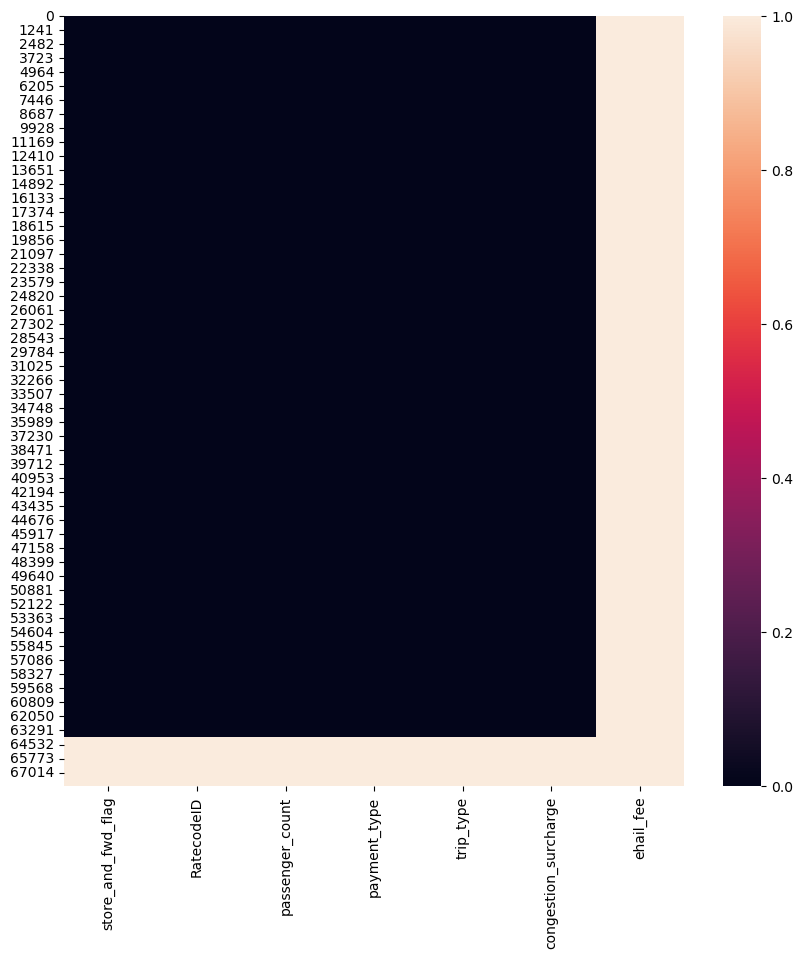

In [16]:
plt.figure(figsize=(10,10))

sns.heatmap(df[['store_and_fwd_flag', 'RatecodeID', 'passenger_count', 'payment_type', 'trip_type', 'congestion_surcharge', 'ehail_fee']].isna())

plt.show()

In [17]:
viewNaNRows()

,Missing Values Count,Missing Values Percentage
Columns,,
ehail_fee,"68,211",100.00 %
trip_type,"4,334",6.35 %
store_and_fwd_flag,"4,324",6.34 %
RatecodeID,"4,324",6.34 %
passenger_count,"4,324",6.34 %
payment_type,"4,324",6.34 %
congestion_surcharge,"4,324",6.34 %


Visualized above are the rows with missing datas, where **white** is missing and **black** is not. We can see that `ehail_fee` is a column with nothing but missing values. On the other hand, the other 6 columns has less than 10% of missing values. This leads to the decision to fully remove every row of data in these 7 columns.

In [18]:
df.drop(columns='ehail_fee', inplace=True)

In [19]:
df = df.dropna()

In [20]:
viewNaNRows()

,Missing Values Count,Missing Values Percentage
Columns,,


### **Data Type Clean-up**

In this section we will ensure columns have appropriate data types, for example:
- dates as datetime
- numerical columns as integers or floats.

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 63877 entries, 0 to 63886
Data columns (total 19 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               63877 non-null  int64  
 1   lpep_pickup_datetime   63877 non-null  object 
 2   lpep_dropoff_datetime  63877 non-null  object 
 3   store_and_fwd_flag     63877 non-null  object 
 4   RatecodeID             63877 non-null  float64
 5   PULocationID           63877 non-null  int64  
 6   DOLocationID           63877 non-null  int64  
 7   passenger_count        63877 non-null  float64
 8   trip_distance          63877 non-null  float64
 9   fare_amount            63877 non-null  float64
 10  extra                  63877 non-null  float64
 11  mta_tax                63877 non-null  float64
 12  tip_amount             63877 non-null  float64
 13  tolls_amount           63877 non-null  float64
 14  improvement_surcharge  63877 non-null  float64
 15  total_a

Based on the list above, we have some mistyped data. We will be changing them to their appropriate types, which are:

**datetime**
- `lpep_pickup_datetime`
- `lpep_dropoff_datetime`

**int64**
- `RatecodeID`
- `passenger_count`
- `payment_type`
- `trip_type`

In [22]:
# string => datetime
df['lpep_pickup_datetime'] = pd.to_datetime(df['lpep_pickup_datetime'])
df['lpep_dropoff_datetime'] = pd.to_datetime(df['lpep_dropoff_datetime'])

# float64 => int64
df['RatecodeID'] = df['RatecodeID'].astype('int64')
df['passenger_count'] = df['passenger_count'].astype('int64')
df['payment_type'] = df['payment_type'].astype('int64')
df['trip_type'] = df['trip_type'].astype('int64')

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 63877 entries, 0 to 63886
Data columns (total 19 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   VendorID               63877 non-null  int64         
 1   lpep_pickup_datetime   63877 non-null  datetime64[ns]
 2   lpep_dropoff_datetime  63877 non-null  datetime64[ns]
 3   store_and_fwd_flag     63877 non-null  object        
 4   RatecodeID             63877 non-null  int64         
 5   PULocationID           63877 non-null  int64         
 6   DOLocationID           63877 non-null  int64         
 7   passenger_count        63877 non-null  int64         
 8   trip_distance          63877 non-null  float64       
 9   fare_amount            63877 non-null  float64       
 10  extra                  63877 non-null  float64       
 11  mta_tax                63877 non-null  float64       
 12  tip_amount             63877 non-null  float64       
 13  tolls_

### **Removing Duplicates**

In this section we will ensure that there are no duplicate rows.

In [23]:
df = df.drop_duplicates()
df

Columns,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2,2023-01-01 00:26:10,2023-01-01 00:37:11,N,1,166,143,1,2.58,14.9,1.0,0.5,4.03,0.0,1.0,24.18,1,1,2.75
1,2,2023-01-01 00:51:03,2023-01-01 00:57:49,N,1,24,43,1,1.81,10.7,1.0,0.5,2.64,0.0,1.0,15.84,1,1,0.00
2,2,2023-01-01 00:35:12,2023-01-01 00:41:32,N,1,223,179,1,0.00,7.2,1.0,0.5,1.94,0.0,1.0,11.64,1,1,0.00
3,1,2023-01-01 00:13:14,2023-01-01 00:19:03,N,1,41,238,1,1.30,6.5,0.5,1.5,1.70,0.0,1.0,10.20,1,1,0.00
4,1,2023-01-01 00:33:04,2023-01-01 00:39:02,N,1,41,74,1,1.10,6.0,0.5,1.5,0.00,0.0,1.0,8.00,1,1,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63882,2,2023-01-31 23:09:22,2023-01-31 23:17:21,N,5,130,205,1,2.75,15.0,0.0,0.0,2.00,0.0,0.3,17.30,1,2,0.00
63883,2,2023-01-31 23:06:18,2023-01-31 23:17:03,N,1,65,181,1,2.44,13.5,1.0,0.5,3.20,0.0,1.0,19.20,1,1,0.00
63884,2,2023-01-31 23:17:03,2023-01-31 23:23:04,N,1,244,116,1,1.40,9.3,1.0,0.5,2.36,0.0,1.0,14.16,1,1,0.00
63885,2,2023-01-31 23:29:18,2023-01-31 23:38:50,N,1,74,238,1,2.47,13.5,1.0,0.5,3.75,0.0,1.0,22.50,1,1,2.75


It appears that we have no duplicate rows, looking at out previous row count is still the same after dropping the duplicates.

### **Timeframe Clean-up**

We have 2 columns that helps us identify timeframes, which are `lpep_pickup_datetime` and `lpep_dropoff_datetime`. To ensure realistic data, we will be removing rows that has the same `lpep_pickup_datetime` and `lpep_dropoff_datetime`.

In [24]:
df = df[df['lpep_pickup_datetime'] != df['lpep_dropoff_datetime']]

### **Data Consistency**

In this section we will be adjusting the data values to ensure consistency. This will only be done to **categorical columns**, which include:
- `VendorID`
- `store_and_fwd_flag`
- `RatecodeID`
- `PULocationID`
- `DOLocationID`
- `payment_type`
- `trip_type`

However, since most of these columns are `integers` we don't have to worry for any inconsistencies, aside from `store_and_fwd_flag`.

In [25]:
df['store_and_fwd_flag'].value_counts()

store_and_fwd_flag
N    63534
Y      284
Name: count, dtype: int64

It appears that we do not have such inconsistencies in our set.

### **Feature Enrichment**

In this section we will be adding features or columns into our existing dataset. This will help us further clean, understand, and analyze our data.

In [26]:
# extracting individual information from Pickup Datetime
df['pu_year'] = df['lpep_pickup_datetime'].dt.year
df['pu_month'] = df['lpep_pickup_datetime'].dt.month
df['pu_date'] = df['lpep_pickup_datetime'].dt.day
df['pu_hour'] = df['lpep_pickup_datetime'].dt.hour
df['pu_month_name'] = df['lpep_pickup_datetime'].dt.month_name()
df['pu_day_name'] = df['lpep_pickup_datetime'].dt.day_name()

# grouping to help with data manipulation
df['pu_day_group'] = df['pu_day_name'].apply(lambda x: 'Weekend' if x in ['Saturday', 'Sunday'] else 'Weekday')
df['time_of_day_group'] = df['pu_hour'].apply(lambda x: timeOfDayGroupper(x))

# time calculations to help with charts
df['trip_duration'] = df['lpep_dropoff_datetime'] - df['lpep_pickup_datetime']
df['trip_duration_minutes'] = df['trip_duration'].dt.total_seconds() / 60

# average speed calculations
df['average_trip_speed'] = (df['trip_distance'] / df['trip_duration_minutes']) * 60

df.head()

Columns,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,pu_year,pu_month,pu_date,pu_hour,pu_month_name,pu_day_name,pu_day_group,time_of_day_group,trip_duration,trip_duration_minutes,average_trip_speed
0,2,2023-01-01 00:26:10,2023-01-01 00:37:11,N,1,166,143,1,2.58,14.9,1.0,0.5,4.03,0.0,1.0,24.18,1,1,2.75,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:11:01,11.016667,14.051437
1,2,2023-01-01 00:51:03,2023-01-01 00:57:49,N,1,24,43,1,1.81,10.7,1.0,0.5,2.64,0.0,1.0,15.84,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:06:46,6.766667,16.049261
2,2,2023-01-01 00:35:12,2023-01-01 00:41:32,N,1,223,179,1,0.00,7.2,1.0,0.5,1.94,0.0,1.0,11.64,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:06:20,6.333333,0.000000
3,1,2023-01-01 00:13:14,2023-01-01 00:19:03,N,1,41,238,1,1.30,6.5,0.5,1.5,1.70,0.0,1.0,10.20,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:05:49,5.816667,13.409742
4,1,2023-01-01 00:33:04,2023-01-01 00:39:02,N,1,41,74,1,1.10,6.0,0.5,1.5,0.00,0.0,1.0,8.00,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:05:58,5.966667,11.061453


### **Outliers Clean Up**

#### `passenger_count`

In [27]:
df['passenger_count'].value_counts().sort_index()

passenger_count
0      335
1    54237
2     5092
3      956
4      364
5     1772
6     1054
7        4
8        2
9        2
Name: count, dtype: int64

There are entries with a **Passenger Count** of **0**, which is not possible for a valid trip. These rows will be removed to ensure the accuracy and reliability of our analysis.

In [28]:
df = df.drop(df[df['passenger_count'] == 0].index)
df

Columns,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,pu_year,pu_month,pu_date,pu_hour,pu_month_name,pu_day_name,pu_day_group,time_of_day_group,trip_duration,trip_duration_minutes,average_trip_speed
0,2,2023-01-01 00:26:10,2023-01-01 00:37:11,N,1,166,143,1,2.58,14.9,1.0,0.5,4.03,0.0,1.0,24.18,1,1,2.75,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:11:01,11.016667,14.051437
1,2,2023-01-01 00:51:03,2023-01-01 00:57:49,N,1,24,43,1,1.81,10.7,1.0,0.5,2.64,0.0,1.0,15.84,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:06:46,6.766667,16.049261
2,2,2023-01-01 00:35:12,2023-01-01 00:41:32,N,1,223,179,1,0.00,7.2,1.0,0.5,1.94,0.0,1.0,11.64,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:06:20,6.333333,0.000000
3,1,2023-01-01 00:13:14,2023-01-01 00:19:03,N,1,41,238,1,1.30,6.5,0.5,1.5,1.70,0.0,1.0,10.20,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:05:49,5.816667,13.409742
4,1,2023-01-01 00:33:04,2023-01-01 00:39:02,N,1,41,74,1,1.10,6.0,0.5,1.5,0.00,0.0,1.0,8.00,1,1,0.00,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:05:58,5.966667,11.061453
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63882,2,2023-01-31 23:09:22,2023-01-31 23:17:21,N,5,130,205,1,2.75,15.0,0.0,0.0,2.00,0.0,0.3,17.30,1,2,0.00,2023,1,31,23,January,Tuesday,Weekday,Nighttime,0 days 00:07:59,7.983333,20.668058
63883,2,2023-01-31 23:06:18,2023-01-31 23:17:03,N,1,65,181,1,2.44,13.5,1.0,0.5,3.20,0.0,1.0,19.20,1,1,0.00,2023,1,31,23,January,Tuesday,Weekday,Nighttime,0 days 00:10:45,10.750000,13.618605
63884,2,2023-01-31 23:17:03,2023-01-31 23:23:04,N,1,244,116,1,1.40,9.3,1.0,0.5,2.36,0.0,1.0,14.16,1,1,0.00,2023,1,31,23,January,Tuesday,Weekday,Nighttime,0 days 00:06:01,6.016667,13.961219
63885,2,2023-01-31 23:29:18,2023-01-31 23:38:50,N,1,74,238,1,2.47,13.5,1.0,0.5,3.75,0.0,1.0,22.50,1,1,2.75,2023,1,31,23,January,Tuesday,Weekday,Nighttime,0 days 00:09:32,9.533333,15.545455


#### `trip_distance`

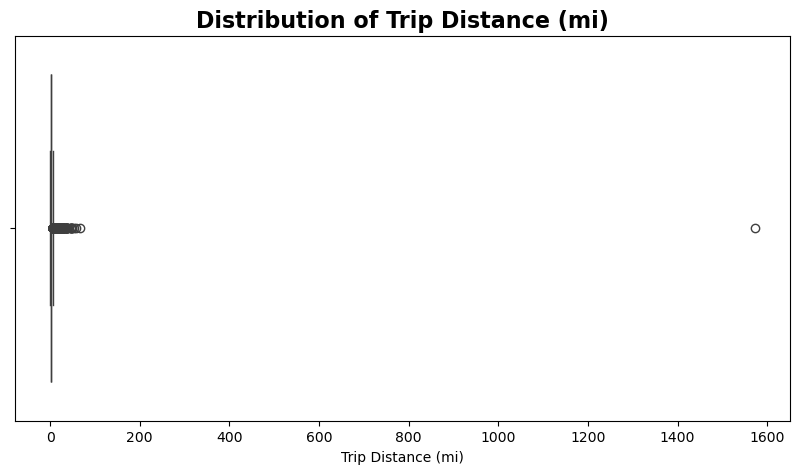

In [29]:
pltFigsize((10,5))

showBoxPlot(df, 'trip_distance', 'Trip Distance (mi)')

plt.show()

In [30]:
df[df['trip_distance'] == df['trip_distance'].max()]

Columns,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,pu_year,pu_month,pu_date,pu_hour,pu_month_name,pu_day_name,pu_day_group,time_of_day_group,trip_duration,trip_duration_minutes,average_trip_speed
33373,2,2023-01-17 18:40:38,2023-01-17 19:04:45,N,5,82,236,1,1571.97,29.97,0.0,0.0,3.04,6.55,1.0,43.31,1,1,2.75,2023,1,17,18,January,Tuesday,Weekday,Evening,0 days 00:24:07,24.116667,3910.913614


There is an entry with a **Trip Distance** of **1571.91 miles**, which is definately not possible especially within a timeframe of 24 minutes. To ensure realistic trips we will remove this data.

In [31]:
df = df.drop(df[df['trip_distance'] == df['trip_distance'].max()].index[0])

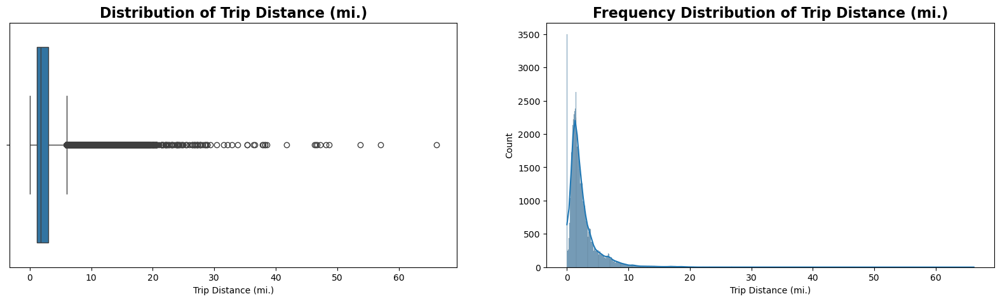

In [32]:
showDistributionCombo(df, 'trip_distance', 'Trip Distance (mi.)')

Using the Histplot, we can also see that we have a significant number of trips that has a `trip_distance` of **0**. For this analysis we will remove these datas.

In [33]:
df = df[df['trip_distance'] > 0]

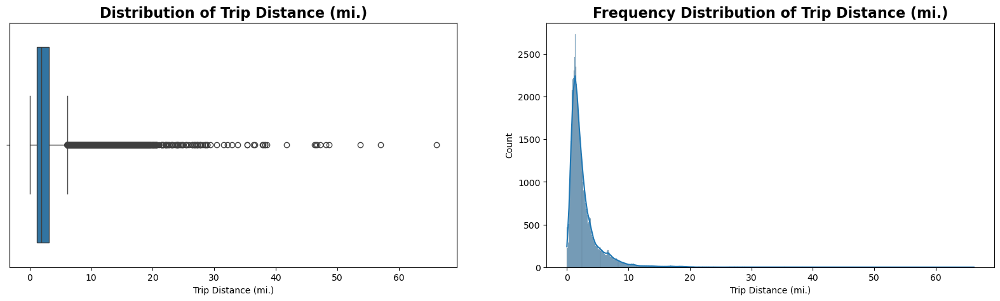

In [34]:
showDistributionCombo(df, 'trip_distance', 'Trip Distance (mi.)')

After removal, we have to recalculate `average_trip_speed` to avoid any dirty datas.

In [35]:
df['average_trip_speed'] = (df['trip_distance'] / df['trip_duration_minutes']) * 60
df['average_trip_speed'].describe()

count    60377.000000
mean        14.191120
std        106.314196
min          0.001668
25%          8.478107
50%         10.568019
75%         13.588933
max      11700.000000
Name: average_trip_speed, dtype: float64

#### `average_trip_speed`

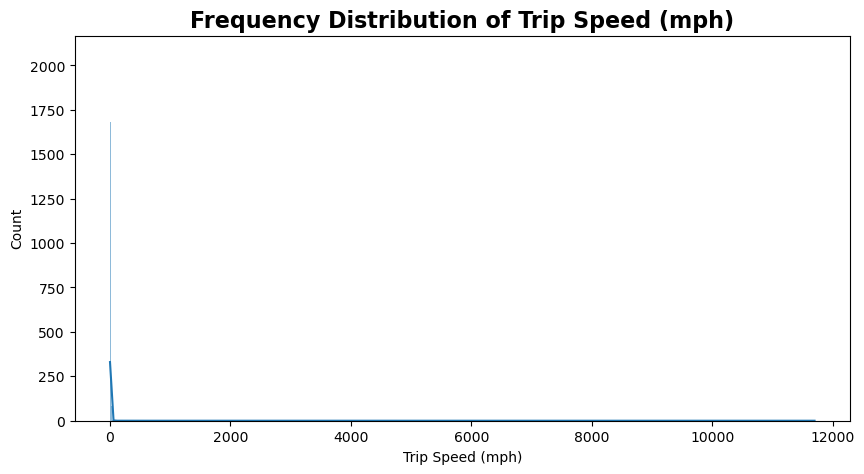

In [36]:
pltFigsize((10,5))

showHistplot(df, 'average_trip_speed', 'Trip Speed (mph)')

plt.show()

We can see absurd numbers in Trip Speed for some of these trips. In the area of New York City, cars are limited to only **55mph** on some highway areas, and **25mph** in city streets. To ensure realistic data, we will remove anything above 55mph.

In [37]:
df = df[df['average_trip_speed'] < 56]
# df

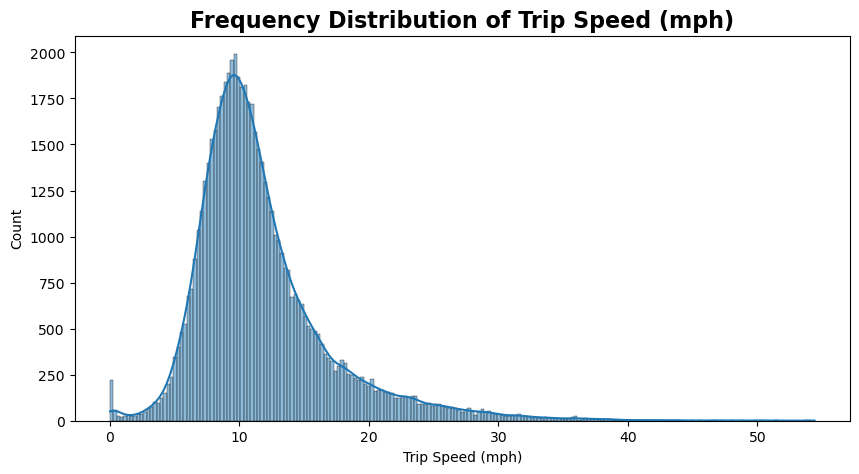

In [38]:
pltFigsize((10,5))

showHistplot(df, 'average_trip_speed', 'Trip Speed (mph)')

plt.show()

#### `trip_duration` / `trip_duration_minutes`

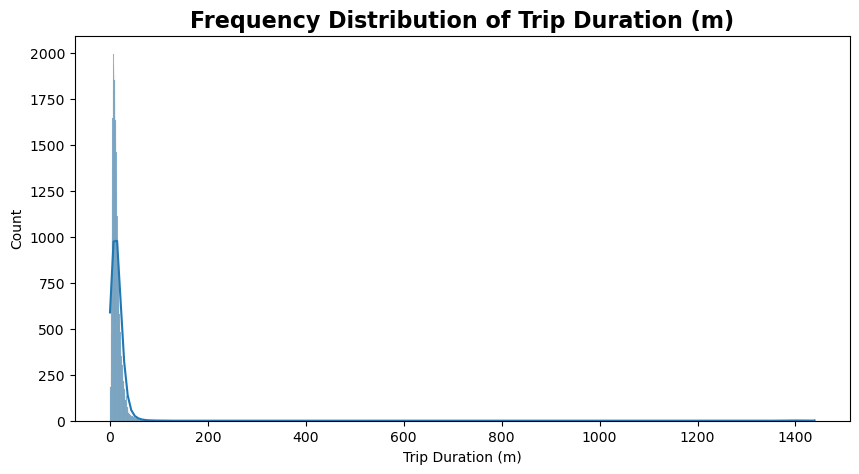

In [39]:
pltFigsize((10,5))

showHistplot(df, 'trip_duration_minutes', 'Trip Duration (m)')

plt.show()

The graph is heavily right-skewed, with a significant number of trips lasting more than **60 minutes**. **60 minutes** is chosen based on the assumption that trips longer than **60 minutes** are uncommon for typical taxi services. Removing trips above this threshold helps to focus on the majority of trips and ensures a more realistic travel durations for the analysis.

In [40]:
df = df[df['trip_duration_minutes'] <= 60]

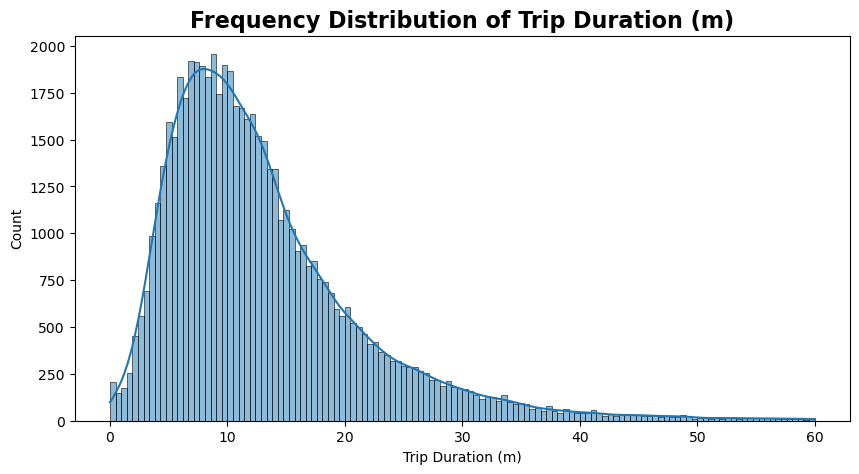

In [41]:
pltFigsize((10,5))

showHistplot(df, 'trip_duration_minutes', 'Trip Duration (m)')

plt.show()

Although the data appears cleaner, let's visualize the relationship between Trip Distance and Trip Duration using a scatter plot.

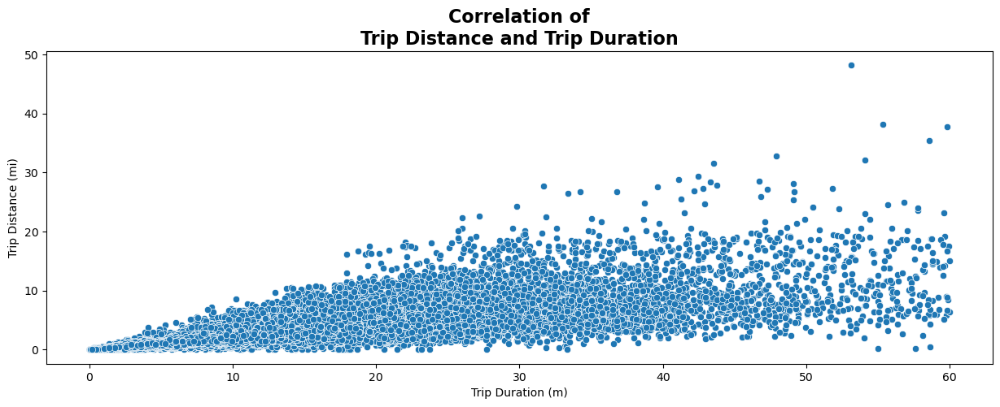

In [42]:
pltFigsize((15,5))

sns.scatterplot(
  data=df,
  x='trip_duration_minutes',
  y='trip_distance',
)

pltTitle('Correlation of\nTrip Distance and Trip Duration')

plt.ylabel('Trip Distance (mi)')
plt.xlabel('Trip Duration (m)')

plt.show()

We can still see a lot of the trips that covers a distance greater than 1 mile but taking  more than 5 minutes. Assuming an average speed of 12mph, these durations take a significant amount of time. Based on this assumption, we will remove these data points to ensure the accuracy and reliability of our analysis.

In [43]:
df = df.drop(df[(df['trip_duration_minutes'] >= 6) & (df['trip_distance'] < 1)].index)

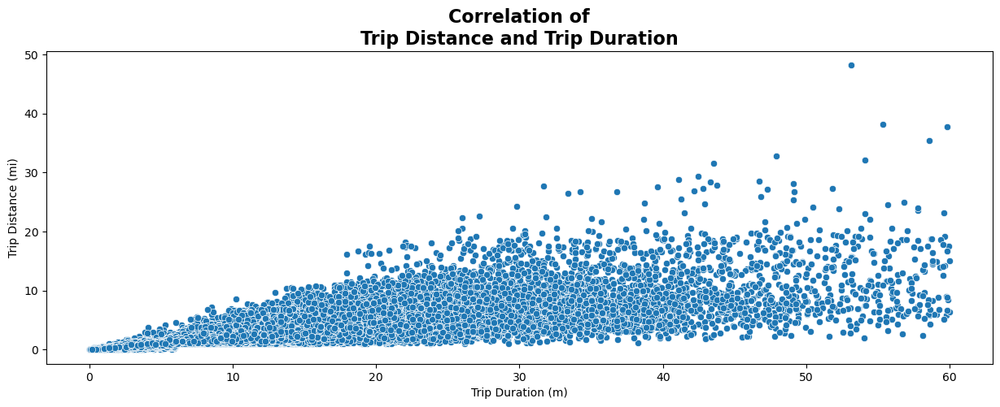

In [44]:
pltFigsize((15,5))

sns.scatterplot(
  data=df,
  x='trip_duration_minutes',
  y='trip_distance',
)

pltTitle('Correlation of\nTrip Distance and Trip Duration')

plt.ylabel('Trip Distance (mi)')
plt.xlabel('Trip Duration (m)')

plt.show()

#### `tip_amount`

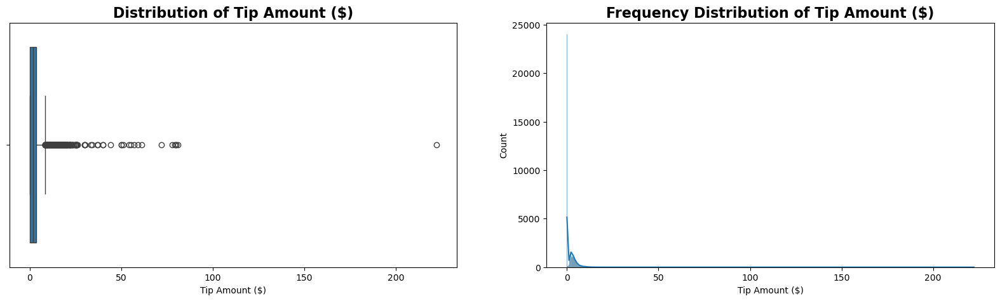

In [45]:
showDistributionCombo(df, 'tip_amount', 'Tip Amount ($)')

As expected, there isn't any set amount for tips, which explains the distribution of data. To help visualize better, we can use a scatter plot.

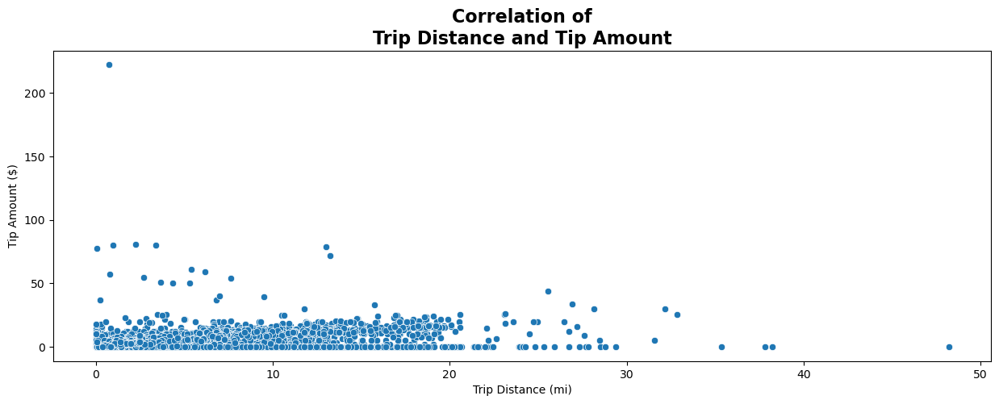

In [46]:
pltFigsize((15,5))

sns.scatterplot(
  data=df,
  x='trip_distance',
  y='tip_amount',
)

pltTitle('Correlation of\nTrip Distance and Tip Amount')

plt.xlabel('Trip Distance (mi)')
plt.ylabel('Tip Amount ($)')

plt.show()

Using the scatter plot, we can quickly see there are 2 outliers here. The first one would be the high tip but low trip distance and the other is high trip distance but low tip amount. However most of the data lies just under 21 miles of trip distance and $25 of tip. Let's remove these 2 rows of datas.

In [47]:
df = df.drop(df[(df['trip_distance'] == df['trip_distance'].max()) | (df['tip_amount'] == df['tip_amount'].max())].index)

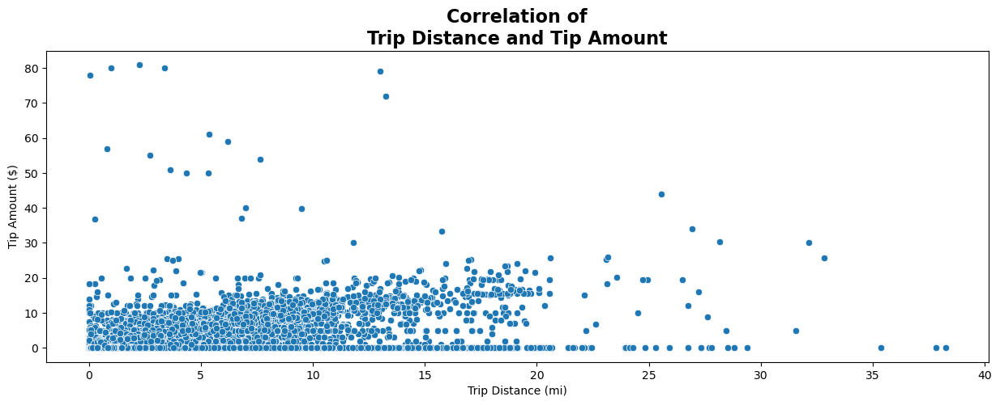

In [48]:
pltFigsize((15,5))

sns.scatterplot(
  data=df,
  x='trip_distance',
  y='tip_amount',
)

pltTitle('Correlation of\nTrip Distance and Tip Amount')

plt.xlabel('Trip Distance (mi)')
plt.ylabel('Tip Amount ($)')

plt.show()

#### `fare_amount`

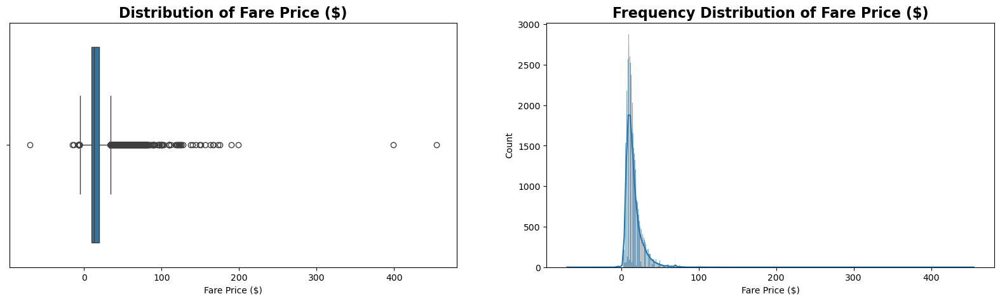

In [49]:
showDistributionCombo(df, 'fare_amount', 'Fare Price ($)')

We can see 2 very distinct sides of fare_price. One side is the negative fare, and the other being above $400. Let's see both of these datas.

In [50]:
negative_fares_df = df[df['fare_amount'] < 0]

In [51]:
negative_fares_count_df = pd.DataFrame(negative_fares_df['payment_type'].value_counts())
negative_fares_count_df['%count'] = negative_fares_count_df['count'] / len(negative_fares_df) * 100
negative_fares_count_df['sum'] = negative_fares_df.groupby('payment_type')['fare_amount'].sum()
negative_fares_count_df

,count,%count,sum
payment_type,,,
3,70,77.777778,-385.7
4,20,22.222222,-76.9


Every negative fare trips falls under **No Charge** and **Dispute**, with 77.8% of them being the former. This may suggest that negative fare trips that fall under **No Charge** may be a discounted ride or a free ride given to loyal customers or perhaps pre-paid trips. For those which falls under **Dispute** may be considered as a dispute in price from pre-paid trips or pre-arranged trips.

### **Unique Data Clean-up**

In this section we shall be checking unique datas. This is done in order to make sure there are no redundant datas, such as "January" & "jan" in the `pu_month_name` column.

In [52]:
pd.set_option('display.max_colwidth', None)

listItem = []
for col in df.columns :
    listItem.append([col, df[col].nunique(), df[col].sort_values().unique()])

df_uniques_per_column = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'], data=listItem)
df_uniques_per_column[df_uniques_per_column['Number of Unique'] <= 23].sort_values('Number of Unique', ascending=False)

,Column Name,Number of Unique,Unique Sample
13,tolls_amount,19,"[0.0, 2.45, 3.0, 5.09, 6.25, 6.55, 6.75, 7.0, 8.55, 9.0, 11.75, 12.75, 13.1, 13.75, 14.75, 19.3, 20.5, 22.75, 36.05]"
10,extra,14,"[-2.5, -1.0, 0.0, 0.5, 1.0, 2.5, 2.75, 3.25, 3.75, 5.0, 5.25, 5.5, 6.0, 7.5]"
7,passenger_count,7,"[1, 2, 3, 4, 5, 6, 7]"
24,pu_day_name,7,"[Friday, Monday, Saturday, Sunday, Thursday, Tuesday, Wednesday]"
26,time_of_day_group,6,"[Afternoon, Early Morning, Evening, Late Morning, Morning, Nighttime]"
4,RatecodeID,5,"[1, 2, 3, 4, 5]"
11,mta_tax,5,"[-0.5, 0.0, 0.5, 1.0, 1.5]"
14,improvement_surcharge,5,"[-1.0, -0.3, 0.0, 0.3, 1.0]"
18,congestion_surcharge,4,"[-2.75, 0.0, 2.5, 2.75]"
16,payment_type,4,"[1, 2, 3, 4]"


Every data here seems to be in order as we have cleaned most up previously. However, there are datas such as `pu_month_name` and `pu_year` which seemed peculiar. To this let's see how many trips each group has.

In [53]:
df.groupby('pu_month_name').count()[['extra']]

Columns,extra
pu_month_name,
December,2
February,1
January,56724


It appears that we have some outliers in this data. As most of the data are in January, we will remove the other rows.

In [54]:
df = df[df['pu_month'] == 1]

In [55]:
pd.set_option('display.max_colwidth', None)

# data uni di tiap kolom
listItem = []
for col in df.columns :
    listItem.append([col, df[col].nunique(), df[col].sort_values().unique()])

df_uniques_per_column = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'], data=listItem)
df_uniques_per_column[df_uniques_per_column['Number of Unique'] <= 23].sort_values('Number of Unique', ascending=False)

,Column Name,Number of Unique,Unique Sample
13,tolls_amount,19,"[0.0, 2.45, 3.0, 5.09, 6.25, 6.55, 6.75, 7.0, 8.55, 9.0, 11.75, 12.75, 13.1, 13.75, 14.75, 19.3, 20.5, 22.75, 36.05]"
10,extra,14,"[-2.5, -1.0, 0.0, 0.5, 1.0, 2.5, 2.75, 3.25, 3.75, 5.0, 5.25, 5.5, 6.0, 7.5]"
7,passenger_count,7,"[1, 2, 3, 4, 5, 6, 7]"
24,pu_day_name,7,"[Friday, Monday, Saturday, Sunday, Thursday, Tuesday, Wednesday]"
26,time_of_day_group,6,"[Afternoon, Early Morning, Evening, Late Morning, Morning, Nighttime]"
4,RatecodeID,5,"[1, 2, 3, 4, 5]"
11,mta_tax,5,"[-0.5, 0.0, 0.5, 1.0, 1.5]"
14,improvement_surcharge,5,"[-1.0, -0.3, 0.0, 0.3, 1.0]"
18,congestion_surcharge,4,"[-2.75, 0.0, 2.5, 2.75]"
16,payment_type,4,"[1, 2, 3, 4]"


With this we know now that this dataset is the **NYC TLC Trip Record of January 2023**

### **Categorical Data Value Change**

Some of the columns from the dataset can be considered as Categorical. To avoid future confusions, these datas will be changed from numerical to their proper names.

In [56]:
VendorIDDictionary = {1: "Creative Mobile Technologies, LLC", 2: "VeriFone Inc."}
RatecodeIDDictionary = {1: "Standard Rate", 2: "JFK", 3: "Newark", 4: "Nassau or Westchester", 5: "Negotiated Fare", 6: "Group Ride"}
PaymentTypeDictionary = {1: "Credit Card", 2: "Cash", 3: "No Charge", 4: "Dispute", 5: "Unknown", 6: "Voided Trip"}
TripTypeDictionary = {1: "Street-hail", 2: "Dispatch"}

df['VendorID'] = df['VendorID'].apply(lambda x: VendorIDDictionary[x])
df['RatecodeID'] = df['RatecodeID'].apply(lambda x: RatecodeIDDictionary[x])
df['payment_type'] = df['payment_type'].apply(lambda x: PaymentTypeDictionary[x])
df['trip_type'] = df['trip_type'].apply(lambda x: TripTypeDictionary[x])

In [57]:
df['pu_location_name'] = df['PULocationID'].apply(lambda x: location_namer(x))
df['do_location_name'] = df['DOLocationID'].apply(lambda x: location_namer(x))
df.head(1)

Columns,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,pu_year,pu_month,pu_date,pu_hour,pu_month_name,pu_day_name,pu_day_group,time_of_day_group,trip_duration,trip_duration_minutes,average_trip_speed,pu_location_name,do_location_name
0,VeriFone Inc.,2023-01-01 00:26:10,2023-01-01 00:37:11,N,Standard Rate,166,143,1,2.58,14.9,1.0,0.5,4.03,0.0,1.0,24.18,Credit Card,Street-hail,2.75,2023,1,1,0,January,Sunday,Weekend,Early Morning,0 days 00:11:01,11.016667,14.051437,Morningside Heights,Lincoln Square West


<hr>

# **3. Data Analysis**

## **Trip Patterns Over Time**

In this section, we will be looking at how trip activities varies across different hours and days in a week. By identifying temporal patterns, we can better understand passenger demand and usage trends.

### **Daily Trip Demand**

First of all let's see the **day-to-day demand** trend. For this we will be using the `lpep_pickup_datetime` rather than `lpep_dropoff_datetime`. This is due to the variation in time which a trip may take.

To analize this we will be using `pu_date`.

In [58]:
daily_trips_demand_df = df.groupby(['pu_date']).count()[['extra']].rename(columns={'extra': 'Trip Count'})
# daily_trips_demand_df.head()

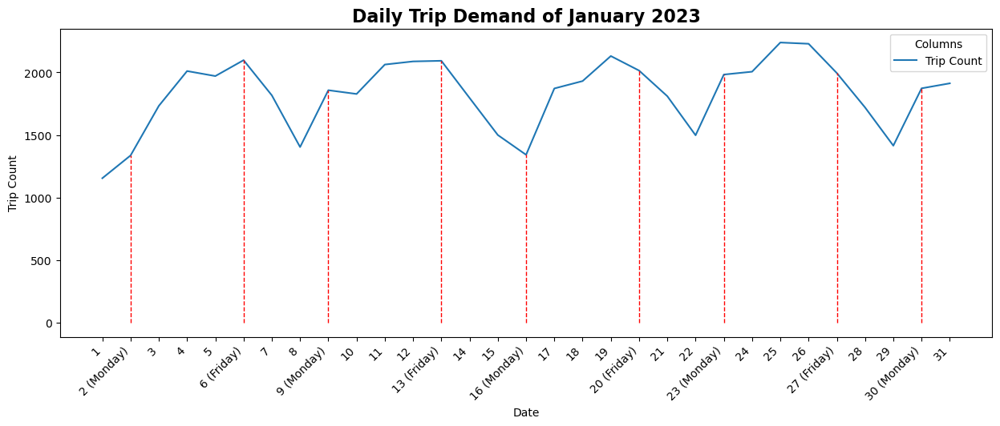

In [59]:
pltFigsize((15,5))

sns.lineplot(daily_trips_demand_df)

day_mapping = {}
for i in range(1, 32):
  day_mapping[i] = f"{i}"
  
  if pd.to_datetime(f"2023-01-{i}").weekday() in [0, 4]:
    day_mapping[i] += f" ({pd.Timestamp(f'2023-01-{i}').day_name()})"

    # adding red helper lines
    plt.vlines(x=i, ymin=0, ymax=daily_trips_demand_df.loc[i], color='red', linestyle='--', linewidth=1)

plt.xlabel("Date")
plt.xticks([x for x in range(1, 32)], [day_mapping[x] for x in range(1, 32)], rotation=45, ha='right')

plt.ylabel("Trip Count")

pltTitle("Daily Trip Demand of January 2023")

plt.show()

From the graph, we can see that the demand peaks around midweek, which is around **Wednesdays** to **Fridays**. This may be due to people getting tired from work as the week goes by and wanting comfort to get to work or to go home.

On the otherside of the spectrum, we have the lowest demand on **Sundays**. This is not always the case, but it is a recurring trend for this month.

Next, let's look at the Hourly Trip Demand on both weekdays and weekends.

### **Hourly Trip Demand**

In [60]:
hourly_overall_traffic_df = df.groupby('pu_hour').count()[['extra']]
# hourly_overall_traffic_df.head()

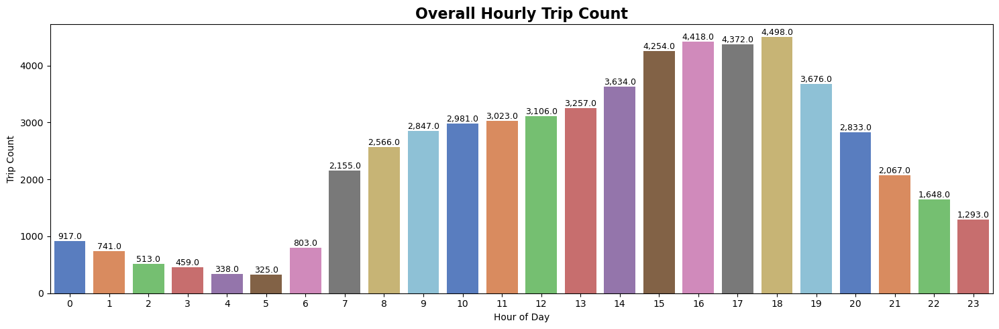

In [61]:
pltFigsize((15,5))

showBarPlot(hourly_overall_traffic_df, 'pu_hour', 'extra', 'Overall Hourly Trip Count', 'Hour of Day', 'Trip Count', hourly_overall_traffic_df.index)

plt.tight_layout()

We can see a huge demand in trips during active hours starting **from 07:00 until 23:00**. We can see a **jump on demand** and stays around the high 4000s, even reaching to 5000s, at **15:00 until 18:00**. This might be due to day to day workers are going home from work. From there the demand starts going down until 23:00, and if we continue this, it keeps coming down until 06:00, where it starts rising again.

In [62]:
weekdays_hourly_overall_traffic_df = df[~(df['pu_day_name'] == 'Saturday') & ~(df['pu_day_name'] == 'Sunday')].groupby('pu_hour').count()[['extra']]
# weekdays_hourly_overall_traffic_df

In [63]:
weekends_hourly_overall_traffic_df = df[(df['pu_day_name'] == 'Saturday') | (df['pu_day_name'] == 'Sunday')].groupby('pu_hour').count()[['extra']]
# weekends_hourly_overall_traffic_df

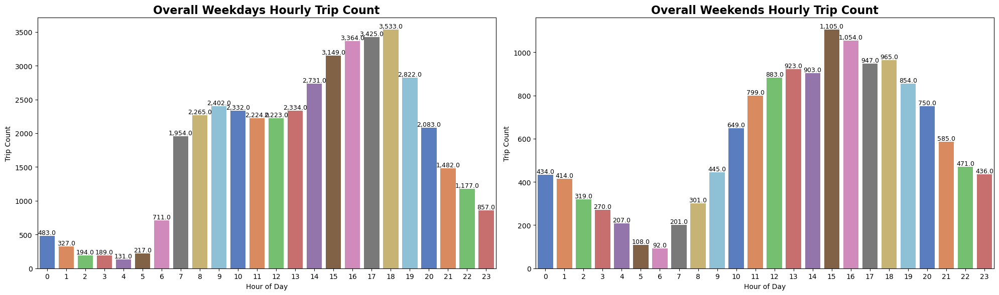

In [64]:
pltFigsize((20,6))

plt.subplot(1,2,1)
showBarPlot(weekdays_hourly_overall_traffic_df, 'pu_hour', 'extra', 'Overall Weekdays Hourly Trip Count', 'Hour of Day', 'Trip Count', weekdays_hourly_overall_traffic_df.index)

plt.subplot(1,2,2)
showBarPlot(weekends_hourly_overall_traffic_df, 'pu_hour', 'extra', 'Overall Weekends Hourly Trip Count', 'Hour of Day', 'Trip Count', weekends_hourly_overall_traffic_df.index)

plt.tight_layout()

It appears that on **weekdays the hourly trend is relatively the same as the overall**. There is, indeed, a drop in numbers, however the trend still prevails. This proves our earlier theory of people going home from work using our services.

On the weekends, we can see a similar trend of trip count as on the weekdays. The number of trips certainly drops by a significant amount comparing to the weekdays trip count. There is also a shift in peak hour comparing to the weekdays. On the weekdays, the peak hour is around 15:00 - 19:00, meanwhile the peak hour on the weekends is around 15:00 - 17:00. While the numbers are alike at **00:00 until 05:00**, it is higher in percentage compared to the peak hours. This is due to the lower numbers in the peak hours.

### **Weekday vs Weekend**

Based on out previous findings, we can see significant difference, both in **numbers (demands)** and **peak hours**. In this section we will see how much of a difference are there between **Weekday** and **Weekend** trips.

In [65]:
day_group_percent_df = pd.pivot_table(
  data=df,
  index='pu_day_group',
  columns='pu_year',
  values='extra',
  aggfunc='count'
).rename(columns={2023: 'Count'})

day_group_percent_df['%Total'] = day_group_percent_df['Count'] / len(df) * 100

day_group_percent_df

pu_year,Count,%Total
pu_day_group,,
Weekday,42609,75.116353
Weekend,14115,24.883647


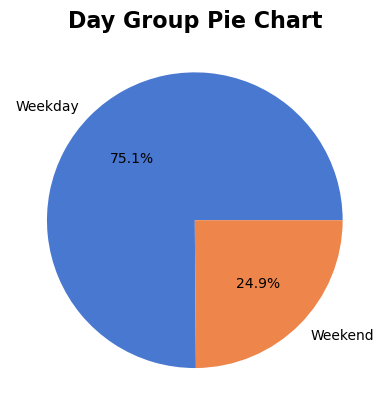

In [66]:
day_group = day_group_percent_df.index
values = day_group_percent_df['%Total']

plt.pie(
  x=values,
  labels=day_group,
  autopct='%1.1f%%',
  colors=sns.color_palette('muted')
)

pltTitle('Day Group Pie Chart')

plt.show()

The pie chart above suggests that Weekdays make up **75.4%** of the trips in January 2023. This maybe due to customers don't really go out on weekends or perhaps they utilize their private vehicles to go out. Taxis are a form of public transportation and will be available everywhere in town. Based on the [New York Post](https://nypost.com/2024/06/26/us-news/nyc-ranked-worlds-most-congested-city-again-inrix), the New York City is the **most congested urban area globally**. This may push the use of taxis rather than private vehicles during weekdays.

### **Conclusion**

We can see recurring trends all month. Trip demands building up from **Mondays** up to **Fridays** and goes down from there, only to go back up. We can see a low number of trips on the **1st of January** which may be because it's New Years and it is Sunday where it is known to have low demand (by looking at the trend). We can also see that the peak trip count is always around **Wednesdays** to **Fridays**. This may be due to people getting tired from work as the week goes by and wanting comfort to get to work or to go home.

**Weekdays** shows a strong number of demands during 'active hours', which starts **from 06:00 until 23:00**. While the **Weekends** show a significatly lower numbers, it still shares a similar trend to **Weekdays**. Aside from the difference in numbers, there is also a shift in peak hours. On the **weekdays**, the peak hour is around **15:00 - 19:00**, meanwhile the peak hour on the **weekends** is around **15:00 - 17:00**. In general, **weekday** trips should provide us with more revenue compared to **weekend** trips. However, this may also be a chance for us to explore ways to encourage more **weekend** trips.

## **The Hotspots**

In this section we shall be diving deeper into the **busiest** `pickup` and `dropoff` locations. For that purpose, we will utilize the `pu_location_name` and `do_location_name` columns. The questions we will be answering in this section will be:
- Which **Pickup Location** (`pu_location_name`) is the busiest?
- Which **Drop-off Location**(`do_location_name`) is the busiest?
- Which **Pickup Location** (`pu_location_name`) is the least busiest?
- Which **Drop-off Location**(`do_location_name`) is the least busiest?
- Which **route** is the most popular?

Since we have over 100 unique locations, we will only be using the top 10 for **the Busiest Locations** and **the most popular route**.

### **Busiest Pickup Locations**

In [67]:
top10_pu_location_df = df[df['pu_day_group'] == 'Weekday'].groupby(['PULocationID', 'pu_location_name'], as_index=False)[['extra']].count().sort_values('extra', ascending=False).head(10)
# top10_pu_location_df

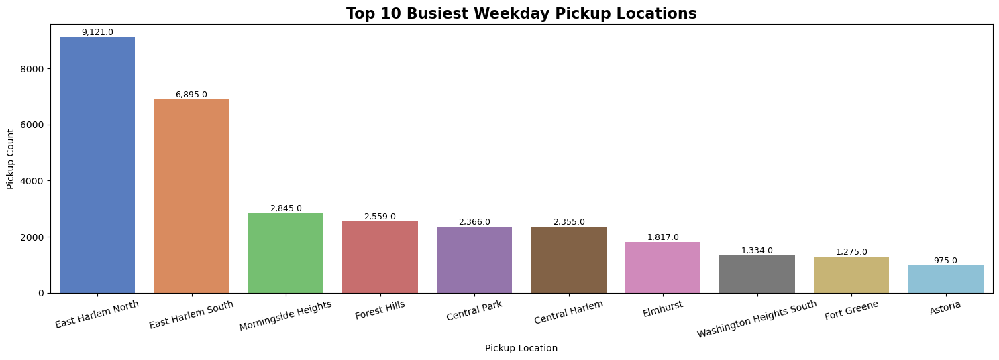

In [68]:
pltFigsize((15,5))

showBarPlot(top10_pu_location_df, 'pu_location_name', 'extra', 'Top 10 Busiest Weekday Pickup Locations', 'Pickup Location', 'Pickup Count', top10_pu_location_df['pu_location_name'])

plt.xticks(top10_pu_location_df['pu_location_name'], rotation=15)

plt.show()

In [69]:
nyc_map = folium.Map(
  location=[40.78059790284368, -73.93774138304246],
  zoom_start=12,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=top10_pu_location_df,
  columns=['PULocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

for x in top10_pu_location_df.index:
  location_id = top10_pu_location_df.loc[x, 'PULocationID']
  trip_count = top10_pu_location_df.loc[x, 'extra']
  group_color = ''

  if location_id in [166, 41, 74, 75, 43]:
    group_color = 'red'
  elif location_id in [244, 7, 82, 95, 97]:
    group_color = 'blue'

  nyc_map.add_child(
    folium.Marker(
      location=center_coordinates_library[location_id]['coords'],
      tooltip=f"{center_coordinates_library[location_id]['zone']} ({location_id})",
      popup=f"Trip Count: {trip_count}",
      icon=folium.Icon(
        color=group_color,
      )
    )
  )

nyc_map.add_child(PU_location_choropleth)

The areas marked on the map is divided into these 3 categories, which are:

|**Category**| **Color** | **LocationID**|
|---|---|---|
|**City Center**|Red|- **Central Park**<br>- **Morningside Heights**<br>- **Central Harlem**<br>- **East Harlem North**<br>- **East Harlem South**|
|**Residential Neighbourhood**|Blue|- **Washington Heights South**<br>- **Astoria**<br>- **Einhurst**<br>- **Forrest Hills**<br>- **Fort Greene**|

As shown in the map and the graph, we can see high concentrations of trips starting from the **City Center**, which is expected. However, we can also see the other significant locations are **Residential** areas, which indicate a strong demand from these neighbourhoods.

Let's see how the weekdend hotspots differ.

In [70]:
top10_weekend_pu_location_df = df[df['pu_day_group'] == 'Weekend'].groupby(['PULocationID', 'pu_location_name'], as_index=False)[['extra']].count().sort_values('extra', ascending=False).head(10)
# top10_weekend_pu_location_df

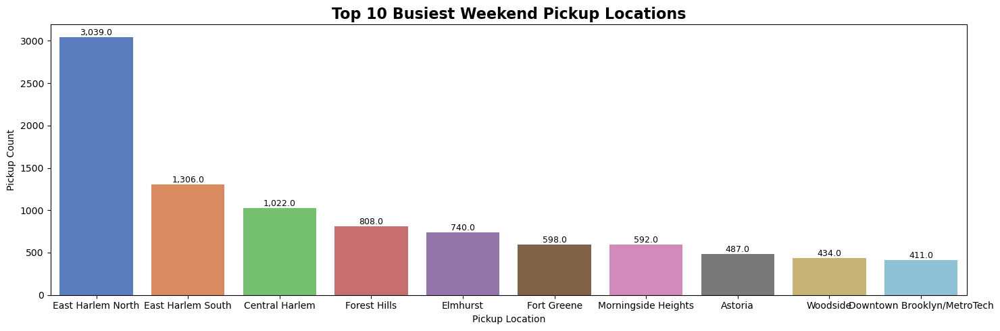

In [71]:
pltFigsize((15,5))

showBarPlot(top10_weekend_pu_location_df, 'pu_location_name', 'extra', 'Top 10 Busiest Weekend Pickup Locations', 'Pickup Location', 'Pickup Count', top10_weekend_pu_location_df['pu_location_name'])

In [72]:
nyc_map = folium.Map(
  location=[40.75708998462197, -73.93450333731836],
  zoom_start=12,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=top10_weekend_pu_location_df,
  columns=['PULocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

for x in top10_weekend_pu_location_df.index:
  location_id = top10_weekend_pu_location_df.loc[x, 'PULocationID']
  trip_count = top10_weekend_pu_location_df.loc[x, 'extra']
  group_color = 'red'

  if location_id in [7, 82, 95, 97, 260]:
    group_color = 'blue'

  nyc_map.add_child(
    folium.Marker(
      location=center_coordinates_library[location_id]['coords'],
      tooltip=f"{center_coordinates_library[location_id]['zone']} ({location_id})",
      popup=f"Trip Count: {trip_count}",
      icon=folium.Icon(
        color=group_color,
      )
    )
  )

nyc_map.add_child(PU_location_choropleth)

The weekend map suggests that most pickups occur in the same areas on weekdays, showing a consistent demand area. The notable change here is a new city center area on `Location ID` **65**, or **Downtown Brooklyn**. This highlights that the importance of **Downtown Brooklyn** as a source of revenue, potentially caused by it's recreational spots and leisure activities.

### **Busiest Drop-off Locations**

In [73]:
top10_do_location_df = df[df['pu_day_group'] == 'Weekday'].groupby(['DOLocationID', 'do_location_name'], as_index=False)[['extra']].count().sort_values('extra', ascending=False).head(10)
# top10_do_location_df

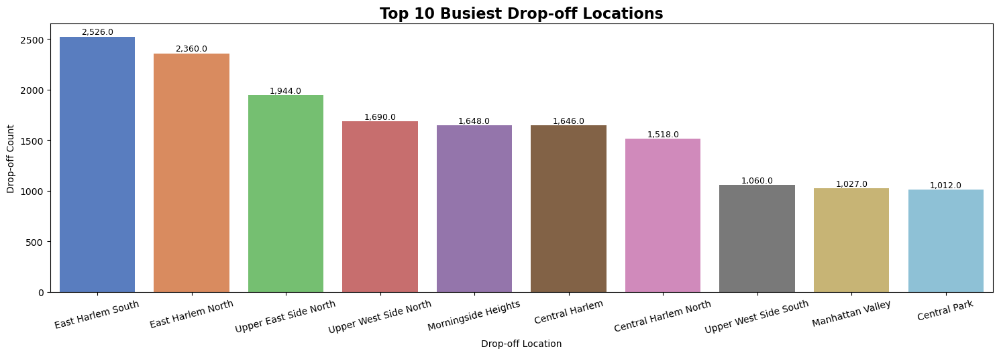

In [74]:
pltFigsize((15,5))

showBarPlot(top10_do_location_df, 'do_location_name', 'extra', 'Top 10 Busiest Drop-off Locations', 'Drop-off Location', 'Drop-off Count', top10_do_location_df['do_location_name'])

plt.xticks(top10_do_location_df['do_location_name'], rotation=15)

plt.show()

In [75]:
nyc_map = folium.Map(
  location=[40.78059790284368, -73.93774138304246],
  zoom_start=12,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=top10_do_location_df,
  columns=['DOLocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

for x in top10_do_location_df.index:
  location_id = top10_do_location_df.loc[x, 'DOLocationID']
  trip_count = top10_do_location_df.loc[x, 'extra']
  group_color = 'red'

  nyc_map.add_child(
    folium.Marker(
      location=center_coordinates_library[location_id]['coords'],
      tooltip=f"{center_coordinates_library[location_id]['zone']} ({location_id})",
      popup=f"Trip Count: {trip_count}",
      icon=folium.Icon(
        color=group_color,
      )
    )
  )

nyc_map.add_child(PU_location_choropleth)

The map above shows that the **top 10 weekday drop-off location** are concentrated in the **city center or the central business district (CBD)**. This suggests that passengers rely on our services to travel to these ares, likely for **business related** trips or other activities in these areas. This indicates our services role in accomodating access to key commercial and business destinations, especially during the weekdays when work-related trips are at their peak.

In [76]:
top10_weekend_do_location_df = df[df['pu_day_group'] == 'Weekend'].groupby(['DOLocationID','do_location_name'], as_index=False)[['extra']].count().sort_values('extra', ascending=False).head(10)
# top10_do_location_df

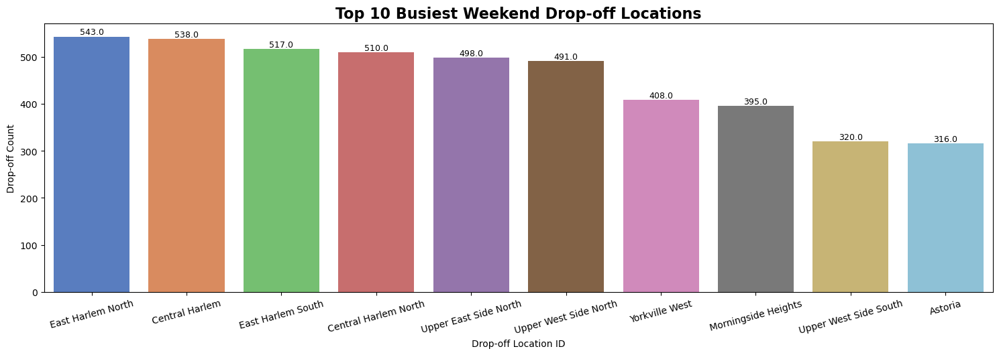

In [77]:
pltFigsize((15,5))

showBarPlot(top10_weekend_do_location_df, 'do_location_name', 'extra', 'Top 10 Busiest Weekend Drop-off Locations', 'Drop-off Location ID', 'Drop-off Count', top10_weekend_do_location_df['do_location_name'])

plt.xticks(top10_weekend_do_location_df['do_location_name'], rotation=15)

plt.show()

In [78]:
nyc_map = folium.Map(
  location=[40.78059790284368, -73.93774138304246],
  zoom_start=12,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=top10_weekend_do_location_df,
  columns=['DOLocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

for x in top10_weekend_do_location_df.index:
  location_id = top10_weekend_do_location_df.loc[x, 'DOLocationID']
  trip_count = top10_weekend_do_location_df.loc[x, 'extra']
  group_color = 'red'

  nyc_map.add_child(
    folium.Marker(
      location=center_coordinates_library[location_id]['coords'],
      tooltip=f"{center_coordinates_library[location_id]['zone']} ({location_id})",
      popup=f"Trip Count: {trip_count}",
      icon=folium.Icon(
        color=group_color,
      )
    )
  )

nyc_map.add_child(PU_location_choropleth)

The **weekend** map suggests that the **top destination** remain mostly consistent, even during the weekends. This findings suggests that our customers use our services not only for daily commutes, but also for leisure activities such as museum visits, parks, and other recreational destinations. This may highlight potential for growth by promoting weekend specific promotions, such as discounts or partnership with local recreational destinations.

The exception here being `Location ID` **7** or **Astoria**. With **Astoria**, a residential area, being in the mix may suggest that daily commuters are going home for the weekends. Interestingly, **Astoria** is also a part of the **Top 10 Busiest Pickup Locations**, highlighting it's importance. This presents us with an opportunity to enhance services in this area to meet the needs of both residents and commuters.

### **Least Busiest Pickup Locations**

In [79]:
uncommon_pu_location_df = df.groupby('PULocationID', as_index=False)[['extra']].count().sort_values('extra')
# uncommon_pu_location_df['extra'].unique()

The numbers above are unique total number of trips from each pickup location. We can see a wide range of numbers, starting from 1 - 12,160. For this sections purposes, we will only be looking at pickup locations that has **total trips under 150**. 150 is chosen by assuming 5 trips per day within a one month (30-day) period, which can be considered as locations that are underperforming.

In [80]:
uncommon_pu_location_df = uncommon_pu_location_df[uncommon_pu_location_df['extra'] < 150]

In [81]:
nyc_map = folium.Map(
  location=[40.69839903673036, -73.95697986007166],
  zoom_start=11,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=uncommon_pu_location_df,
  columns=['PULocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

nyc_map.add_child(PU_location_choropleth)

In [82]:
uncommon_weekend_pu_location_df = df[df['pu_day_group'] == 'Weekend'].groupby('PULocationID', as_index=False)[['extra']].count().sort_values('extra')
uncommon_weekend_pu_location_df['extra'].unique()

array([   1,    2,    3,    4,    5,    6,    7,    8,    9,   10,   11,
         12,   13,   14,   16,   17,   20,   21,   22,   27,   30,   32,
         39,   41,   48,   69,   70,   74,   77,   78,   87,   93,   94,
        107,  120,  122,  123,  124,  150,  152,  159,  162,  176,  209,
        230,  280,  340,  356,  410,  411,  434,  487,  592,  598,  740,
        808, 1022, 1306, 3039], dtype=int64)

For the weekends, we will not be using the 150 threshold number, because in general, the weekend trips only makes up **25%** of the total trips in **January 2023**. For this, we will be using a threshold of **60**, assuming an average daily trip of 2 within a one month (30 days) period.

In [83]:
uncommon_weekend_pu_location_df = uncommon_weekend_pu_location_df[uncommon_weekend_pu_location_df['extra'] < 60]

In [84]:
nyc_map = folium.Map(
  location=[40.69839903673036, -73.95697986007166],
  zoom_start=11,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=uncommon_weekend_pu_location_df,
  columns=['PULocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

nyc_map.add_child(PU_location_choropleth)

We can see that locations with lower pickup numbers are generally **in residential areas and farther from the city center**. This is likely due to being less accessible or **being to far from the city area**, which may lead to potential customers prefering other methods of transportation. We can also see that the areas with bluer tint are closer in proximity to the city center, which may indicate that (potential) customers are not willing to pay too much for a single trip.

This is also consistent with the weekend trips. In the weekend heatmap, we can see that roughly the same areas produce lower numbers. This may indicate 2 things, the first one would be that potential customers are not willing to pay a higher cost trips, leading them into using other means of tranportations. The second would be that in weekends people from these areas just don't go out too much, or even if they did, they would probably utilize private vehicles so they can go anywhere easier without relying on our services. 

In order to overcome this, it is probably wise to **introduce promotions to encourage the use of taxi** from these further areas to the city center.

### **Least Busiest Drop-off Locations**

In [85]:
uncommon_do_location_df = df[df['pu_day_group'] == 'Weekday'].groupby('DOLocationID', as_index=False)[['extra']].count().sort_values('extra')
uncommon_do_location_df['extra'].unique()

array([   1,    2,    3,    4,    5,    6,    7,    9,   10,   11,   12,
         13,   14,   15,   16,   17,   18,   19,   20,   21,   22,   23,
         24,   25,   26,   27,   28,   29,   30,   31,   33,   34,   35,
         36,   37,   38,   39,   41,   42,   43,   44,   45,   46,   47,
         48,   49,   50,   51,   54,   55,   57,   58,   59,   60,   64,
         69,   71,   73,   77,   81,   82,   83,   87,   90,   93,   94,
         95,   96,   97,   99,  100,  102,  104,  106,  108,  111,  113,
        114,  117,  119,  120,  123,  124,  131,  134,  145,  149,  151,
        161,  166,  169,  175,  182,  186,  187,  190,  192,  193,  195,
        221,  223,  226,  240,  249,  250,  259,  260,  266,  267,  269,
        272,  276,  278,  283,  294,  311,  313,  323,  336,  352,  366,
        414,  483,  504,  514,  546,  563,  587,  588,  601,  608,  609,
        782,  793,  935,  956,  988, 1012, 1027, 1060, 1518, 1646, 1648,
       1690, 1944, 2360, 2526], dtype=int64)

For the weekday least busiest Drop-off locations, we will be using a threshold of 60, assuming a daily drop-off of 2 withing a month (30 day) period.

In [86]:
uncommon_do_location_df = uncommon_do_location_df[uncommon_do_location_df['extra'] < 60]

In [87]:
nyc_map = folium.Map(
  location=[40.69839903673036, -73.95697986007166],
  zoom_start=11,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=uncommon_do_location_df,
  columns=['DOLocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

nyc_map.add_child(PU_location_choropleth)

In [88]:
uncommon_weekend_do_location_df = df[df['pu_day_group'] == 'Weekend'].groupby('DOLocationID', as_index=False)[['extra']].count().sort_values('extra')
uncommon_weekend_do_location_df['extra'].unique()

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  19,  20,  22,  23,  24,  25,  26,  27,  28,
        31,  32,  33,  34,  35,  38,  39,  40,  43,  45,  46,  47,  49,
        52,  53,  55,  56,  57,  58,  59,  60,  61,  62,  63,  65,  66,
        67,  69,  71,  72,  73,  75,  79,  82,  83,  89,  92,  94,  98,
       105, 114, 129, 134, 139, 147, 149, 159, 163, 170, 175, 178, 181,
       192, 209, 213, 270, 276, 300, 301, 312, 316, 320, 395, 408, 491,
       498, 510, 517, 538, 543], dtype=int64)

For the weekday least busiest Drop-off locations, we will be using a threshold of 45.

In [89]:
uncommon_weekend_do_location_df = uncommon_weekend_do_location_df[uncommon_weekend_do_location_df['extra'] < 45]

In [90]:
nyc_map = folium.Map(
  location=[40.69839903673036, -73.95697986007166],
  zoom_start=11,
  tiles='CartoDB positron'
)

PU_location_choropleth = folium.Choropleth(
  geo_data='NYC Taxi Zones.geojson',
  data=uncommon_weekend_do_location_df,
  columns=['DOLocationID', 'extra'],
  key_on='feature.properties.location_id',
  line_weight=0.3
)

nyc_map.add_child(PU_location_choropleth)

We can see a **mutual characteristic** with both **weekday** and **weekend** map. Both clearly shows that most of the areas are located within the NYC TLC service area perimeter. This further proves that customers are less likely to be using our services for longer distances, perhaps due to the higher fare.

We can see, however, there are 'hotspots' towards the southern area of Manhattan. As we know, Manhattan is the most densely populated area in NYC. This may suggest that our customers are less likely to go to that area of town to avoid the traffic, unless for urgent or business related matters.

### **Most Popular Routes**

A **route** is made by combining both `pu_location_name` and `do_location_name`, with a format of `pu_location_name`-`do_location_name`.

In [91]:
df_routes = df['pu_location_name'].astype(str) + ' -\n' + df['do_location_name'].astype(str)
df_routes = pd.DataFrame({
  'routes': df_routes,
  'extra': df['extra']
})

In [92]:
df_top10_routes_count = df_routes.groupby('routes', as_index=False)[['extra']].count().sort_values('extra', ascending=False).head(10)
df_top10_routes_count

,routes,extra
1370,East Harlem North -\nEast Harlem South,1866
1504,East Harlem South -\nEast Harlem North,1376
1448,East Harlem North -\nUpper East Side North,1149
1416,East Harlem North -\nMorningside Heights,898
1995,Forest Hills -\nForest Hills,889
1355,East Harlem North -\nCentral Harlem,776
1450,East Harlem North -\nUpper West Side North,679
1465,East Harlem North -\nYorkville West,656
1356,East Harlem North -\nCentral Harlem North,646
1357,East Harlem North -\nCentral Park,611


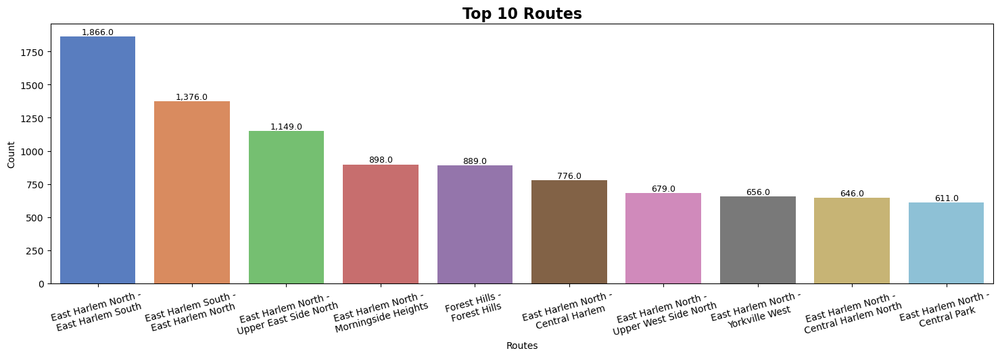

In [93]:
pltFigsize((15,5))

showBarPlot(df_top10_routes_count, 'routes', 'extra', 'Top 10 Routes', 'Routes', 'Count', df_top10_routes_count['routes'])

plt.xticks(df_top10_routes_count['routes'], rotation=15)

plt.show()

The most popular route appears to be the **East Harlem North - East Harlem South** route, closely followed by the other way around. The graph also proves that **East Harlem North** is the hottest `Pickup Location`, by having **70%** of the top 10 filled with routes starting with **East Harlem North**. With all of this data, we can prove that `PULocationID` and `DOLocationID` **East Harlem North** and **East Harlem South** is the busiest locations.

## **Passenger Behaviour**

In this section we will be looking at how our passengers behaviour. The behaviour we will be analyzing will include:
- Solo vs Group rides
- Street Hails vs Dispatch
- Payment Types

### **Solo vs Group Rides**

In [94]:
passenger_count_distribution_df = pd.DataFrame({
    'Count': [
      len(df[df['passenger_count'] == 1]),
      len(df[df['passenger_count'] > 1]),
    ]
  },
  index=['Solo', 'Group'],
)

passenger_count_distribution_df['%Total'] = passenger_count_distribution_df['Count'] / len(df) * 100

passenger_count_distribution_df

,Count,%Total
Solo,48297,85.143854
Group,8427,14.856146


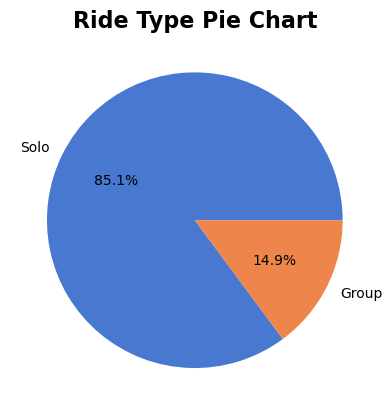

In [95]:
ride_type = passenger_count_distribution_df.index
values = passenger_count_distribution_df['%Total']

plt.pie(
  x=values,
  labels=ride_type,
  autopct='%1.1f%%',
  colors=sns.color_palette('muted')
)

pltTitle('Ride Type Pie Chart')

plt.show()

As we can see, **Solo trips** makes up **85%** of all the trips in **January 2023**. This indicates that our services primarily provide services for individuals, which is likely due to convenience and the flexibility of travelling alone. While the other **15%** may indicate situations where traveling together is a priority, perhaps to reduce costs per person. This may be an opportunity to improve our services to accomodate solo travelers while also promoting group ride options to meet the needs of shared travel scenarios.

### **Street Hail vs Dispatch**

In [96]:
trip_type_distribution_df = pd.DataFrame({
    'Count': [
      len(df[df['trip_type'] == 'Street-hail']),
      len(df[df['trip_type'] == 'Dispatch']),
    ]
  },
  index=['Street-hail', 'Dispatch'],
)

trip_type_distribution_df['%Total'] = trip_type_distribution_df['Count'] / len(df) * 100

trip_type_distribution_df

,Count,%Total
Street-hail,56032,98.780058
Dispatch,692,1.219942


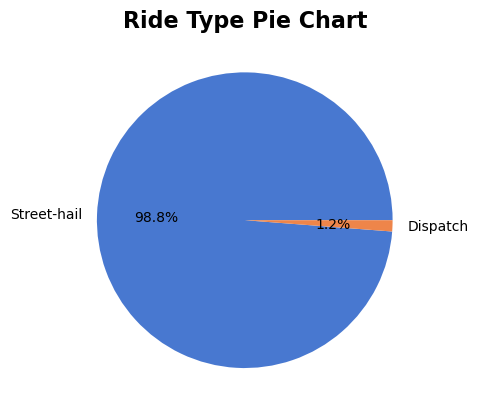

In [97]:
trip_type = trip_type_distribution_df.index
values = trip_type_distribution_df['%Total']

plt.pie(
  x=values,
  labels=trip_type,
  autopct='%1.1f%%',
  colors=sns.color_palette('muted')
)

pltTitle('Ride Type Pie Chart')

plt.show()

The graph above shows us that **98.8%** of our trips were **Street-hail** trips. This highlights the preference for on-the-spot taxi services within our customer base. This also indicates that that passengers rely heavily on the conveniece of hailing taxis directly from the street, rather than making a reservation or pre-booked rides through mobile-apps or other methods. This customer behaviour highlights our sevices high-availability and high-accessibility from accross the town. With this insight, it is key for us to maintain and perhaps further improve our strong presence in areas with heavy foot traffic.

### **Payment Types**

In [98]:
payment_type_count_df = pd.pivot_table(
  data=df,
  index='payment_type',
  columns='pu_year',
  values='extra',
  aggfunc='count'
).rename(columns={2023: 'Count'})

payment_type_count_df['%Total'] = payment_type_count_df['Count'] / len(df) * 100

payment_type_count_df

pu_year,Count,%Total
payment_type,,
Cash,20102,35.438262
Credit Card,36317,64.024046
Dispute,62,0.109301
No Charge,243,0.428390


Our data provides us with **5** different `payment_types`. However, on further examination we can see that the unique values is not just payment methods, it is also trip category. For example, the `payment_type` '**Dispute**' means that there is a dispute on something between the taxi driver and the customer. Another one is '**No Charge**', this means that the customer was not charged for the trip for whatever reason it may be. So for this section we will only be using the '**Cash**' and '**Credit Card**' `payment_type`.

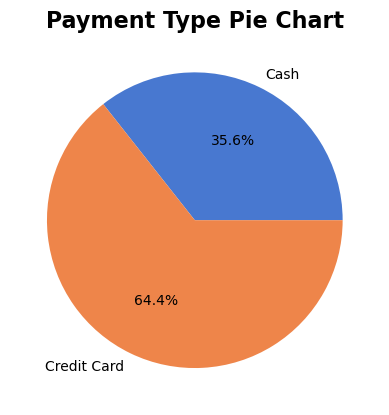

In [99]:
payment_type = payment_type_count_df.iloc[:2].index
values = payment_type_count_df.iloc[:2]['%Total']

plt.pie(
  x=values,
  labels=payment_type,
  autopct='%1.1f%%',
  colors=sns.color_palette('muted')
)

pltTitle('Payment Type Pie Chart')

plt.show()

As the data suggests, both **Cash** and **Credit Card** makes up 99.1% of the data we have. But since we are not using the other 3 `payment_types`, **Credit Card** makes up **64.3%** of the data. Credit cards are made to simplify transactions so that both parties don't have to scavange for that missing cent. Since NYC is heavily congested, having a quick transaction is most preferred by both the drivers and customers to make things quick.

But is there any correlation between payments using **Cash** or **Credit Card** with the `total fare amount`

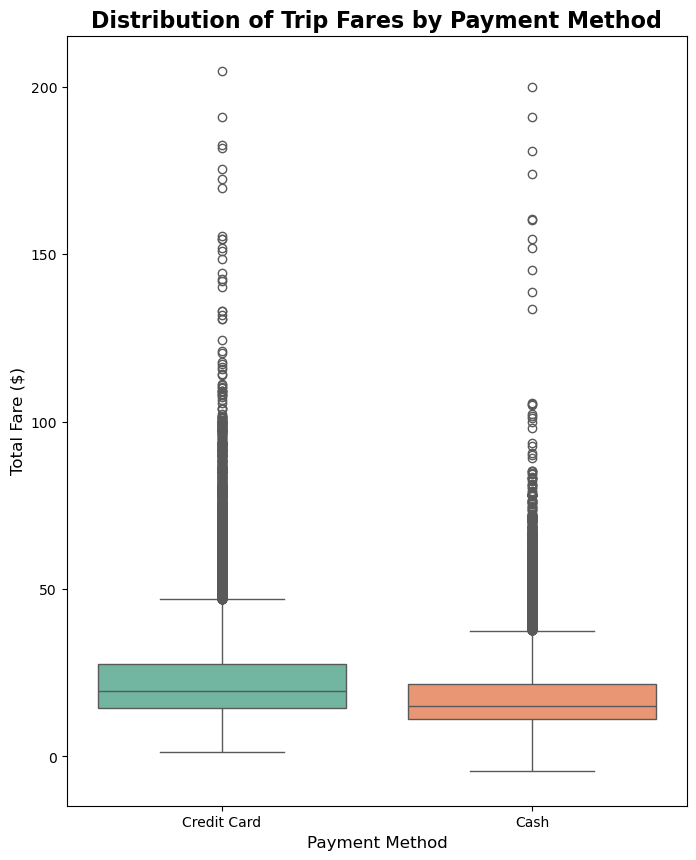

In [100]:
plt.figure(figsize=(8, 10))
sns.boxplot(data=df[((df['payment_type'] == 'Credit Card') | (df['payment_type'] == 'Cash')) & (df['total_amount'] < 300)], x='payment_type', y='total_amount', palette='Set2')

pltTitle('Distribution of Trip Fares by Payment Method')

plt.xlabel('Payment Method', fontsize=12)
plt.ylabel('Total Fare ($)', fontsize=12)

plt.show()

The graph above shows us the distribution of trip fares by payment type. It shows us that **Credit Card** payment is slightly favored for higher fares than **Cash**. Although the overall difference is slight, the difference is more apparent when looking at both the outliers and the position of the boxes. This suggests that passengers paying with **Credit Card** are likely to have higher fares, potentially due to the convenience of card payments. On the other hand, **Cash** payments are preffered for lower fare trips, possibly due to shorter trips or passengers who preffers cash.

## **Fares and Tips**

In this section we will be looking into the core financial aspects of the trips, which include `fare_amount`, `total_amount`, and `tip_amount`. Things we will be looking into in this section are:
- The distribution of `fare_amount`
- Factors that are influencing `tip_amount`
- `payment_type` preference based on `fare_amount` and `tip_amount`

### **Distribution of `fare_amount`**

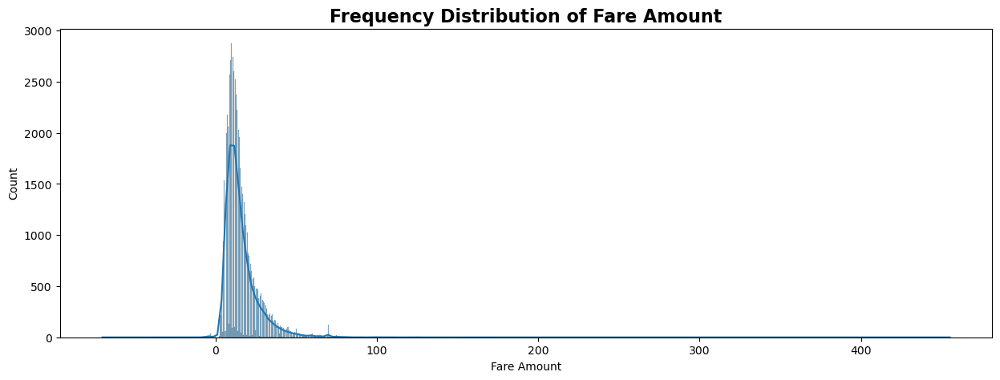

In [101]:
pltFigsize((15,5))

showHistplot(df, 'fare_amount', 'Fare Amount')

Since we have a big spread of data, we are going to see specifically fare amounts that are between $0 - $100 to have a better view.

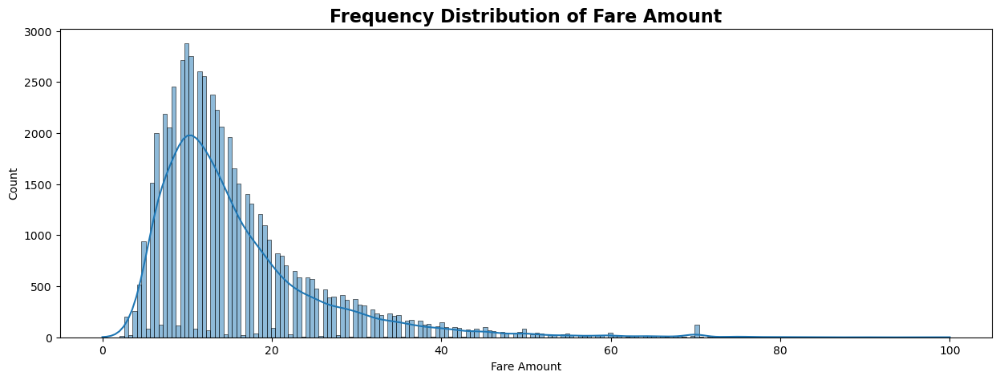

In [102]:
pltFigsize((15,5))

showHistplot(df[(df['fare_amount'] > 0) & (df['fare_amount'] <= 100)], 'fare_amount', 'Fare Amount')

As we can see, most of our fares are located between \$5 - \$20, indicating that our services are relied for shorter trips. This trend suggests that passengers rely on our services for quick and local commutes, rather than longer journeys. This highlights the convenience and accessibility of our services for everyday travel needs. With this insight, we could perhaps further improve our services for (potential) customers who are looking for affordable and reliable form of transportation.

### **Factors of `tip_amount`**

Tip amount is something we cannot really control, as it is heavily based by the genorosity of our customers. For this, we will be using the `trip_distance`, `trip_duration_minutes`, and `fare_amount` to see if there are any correlation with the `tip_amount`. As these datas are not normally distributed, we will be using the **spearman method**

In [103]:
corr_tip_amount_df = df[['tip_amount','trip_distance', 'trip_duration_minutes', 'fare_amount']].corr('spearman')

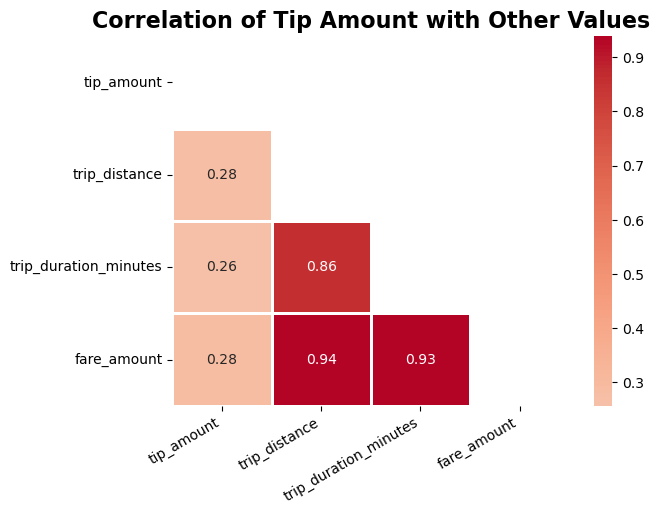

In [104]:
sns.heatmap(
  data=corr_tip_amount_df,
  annot=True,
  cmap='coolwarm',
  center=0,
  linewidths=2,
  mask=np.triu(corr_tip_amount_df),
)

pltTitle('Correlation of Tip Amount with Other Values')

plt.xlabel("")
plt.ylabel("")

plt.xticks(rotation=30, ha='right')

plt.show()

We can see that `tip_amount` does not correlate strongly with `trip_distance`, `trip_duration_minutes`, and `fare_amount`. This findings suggests that these factors only play a minor role in influencing tipping behaviour. It appears that passengers tend to base their tipping on other factors, such as **service quality**, **driver performance**, or just **personal tipping habits**. This highlights the importance of focusing on customer satisfaction to encourage tipping, rather than just trip characteristics.

### **`payment_type` Preference Based on `fare_amount` and `tip_amount`**

Previously, we figured that **Credit Cards** are preferred for higher fares (`total_amount`) compared to **Cash**. In this section we will see a more in depth analysis on that matter. 

#### `fare_amount`

We will be grouping `fare_amount` into several groups to help us better understand this. The groups will be:
- **`fare_amount` <= $10**
- **$10 > `fare_amount` <= $25**
- **$25 > `fare_amount` <= $50**
- **$50 > `fare_amount` <= $100**
- **`fare_amount` > $100**

In [105]:
fare_group_payment_type_df = pd.DataFrame({
  'Credit Card': [
    df[(df['payment_type'] == 'Credit Card') & (df['fare_amount'] <= 10)]['extra'].count(),
    df[(df['payment_type'] == 'Credit Card') & (df['fare_amount'] > 10) & (df['fare_amount'] <= 25)]['extra'].count(),
    df[(df['payment_type'] == 'Credit Card') & (df['fare_amount'] > 25) & (df['fare_amount'] <= 50)]['extra'].count(),
    df[(df['payment_type'] == 'Credit Card') & (df['fare_amount'] > 50) & (df['fare_amount'] <= 100)]['extra'].count(),
    df[(df['payment_type'] == 'Credit Card') & (df['fare_amount'] > 100)]['extra'].count(),
  ],
  'Cash': [
    df[(df['payment_type'] == 'Cash') & (df['fare_amount'] <= 10)]['extra'].count(),
    df[(df['payment_type'] == 'Cash') & (df['fare_amount'] > 10) & (df['fare_amount'] <= 25)]['extra'].count(),
    df[(df['payment_type'] == 'Cash') & (df['fare_amount'] > 25) & (df['fare_amount'] <= 50)]['extra'].count(),
    df[(df['payment_type'] == 'Cash') & (df['fare_amount'] > 50) & (df['fare_amount'] <= 100)]['extra'].count(),
    df[(df['payment_type'] == 'Cash') & (df['fare_amount'] > 100)]['extra'].count(),
  ]
},
index=[
  'x <= $10',
  '$10 > x <= $25',
  '$25 > x <= $50',
  '$50 > x <= $100',
  'x > $100',
])

fare_group_payment_type_df

,Credit Card,Cash
x <= $10,10870,7049
$10 > x <= $25,20430,10265
$25 > x <= $50,4509,2461
$50 > x <= $100,486,312
x > $100,22,15


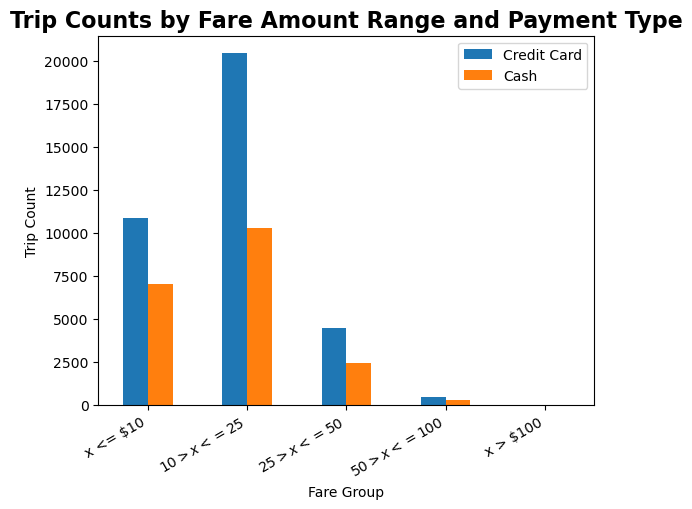

In [106]:
fare_group_payment_type_df.plot(kind='bar')

pltTitle("Trip Counts by Fare Amount Range and Payment Type")

plt.xlabel('Fare Group')
plt.ylabel('Trip Count')

plt.xticks(rotation=30, ha='right')

plt.show()

As we know from earlier findings, **Credit Card** payments is favored on **64.4%** of trips that happened in **January 2023**. This might be the reason for the higher numbers accross the board for **Credit Card** payments. The convenience of **Credit Card** payments may be the main reason of their high numbers, especially for passengers looking for a **cashless and simple payment process**. We can also see a stark difference in numbers in the **$10 - $25** fare group, compared to other groups. This may indicate that **Credit Cards** are the preferred choice for **medium-range fares**, possibly due to the simplicity compared to counting cash on this fare range.

#### `tip_amount`

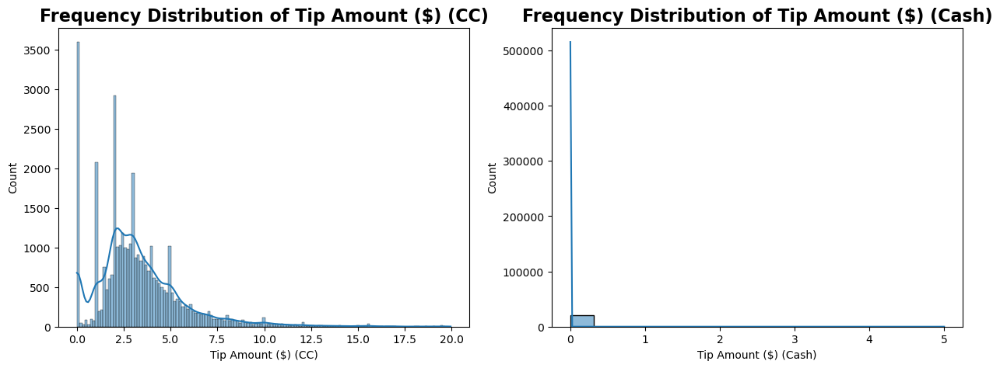

In [107]:
pltFigsize((15,5))

plt.subplot(1,2,1)
showHistplot(df[(df['payment_type'] == 'Credit Card') & (df['tip_amount'] < 20)], 'tip_amount', 'Tip Amount ($) (CC)')

plt.subplot(1,2,2)
showHistplot(df[(df['payment_type'] == 'Cash')], 'tip_amount', 'Tip Amount ($) (Cash)')

In [108]:
df[(df['payment_type'] == 'Cash')]['tip_amount'].value_counts()

tip_amount
0.0    20101
5.0        1
Name: count, dtype: int64

The graph above shows that all trips that generate tips are coming from **Credit Card** payments. This suggests that passengers may be more cautious when spending physical **Cash**, possibly to be prepared for other immediate needs. **Credit Cards** provice the conveniece of directly entering the tip amount, making passengers more likely to leave a tip without the sense of loosing physical **Cash** that may come in handy for other needs.

## **Revenue Analysis**

In this section, we analyze the revenue generated by trips to see patterns and insights. By evaluating these datas, we aim to further understand what factors influence revenue. The questions that will be addresses here are as such:
- Which `time_of_day_group` generate the highest revenue?
- How much does airport trips contribute to revenue?
- How much does out of county trips contribute to revenue?
- How does `RatecodeID` affect revenue?
- What makes up the overall revenue?

We will be using `total_amount` for calculating revenue here.

### **Which `time of day group` generate the highest revenue?**

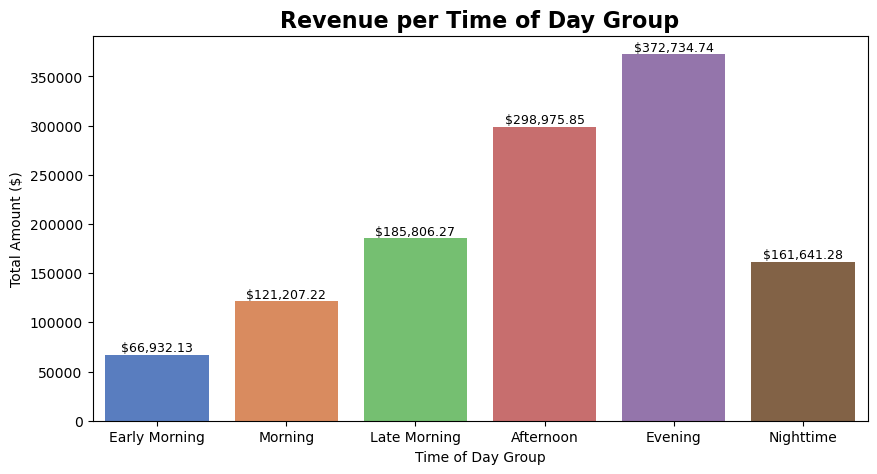

In [109]:
pltFigsize((10,5))

sns.barplot(
  data=df,
  x='time_of_day_group',
  y='total_amount',
  hue='time_of_day_group',
  estimator='sum',
  ci=False,
  palette='muted',
)

showBarNumbers("$", 2)

pltTitle('Revenue per Time of Day Group')

plt.xlabel('Time of Day Group')
plt.ylabel('Total Amount ($)')

plt.show()

In [110]:
todg_revenue_df = pd.DataFrame(df.groupby('time_of_day_group')['total_amount'].sum())
todg_revenue_df['%Total'] = todg_revenue_df['total_amount'] / todg_revenue_df['total_amount'].sum() * 100
todg_revenue_df

,total_amount,%Total
time_of_day_group,,
Afternoon,298975.85,24.764058
Early Morning,66932.13,5.543963
Evening,372734.74,30.873479
Late Morning,185806.27,15.390264
Morning,121207.22,10.039549
Nighttime,161641.28,13.388687


In the span of one month, **Evening** trips  generates the highest revenue, contributing **31%** of the total. This is driven by the high amount of trips between **16:00 - 18:59**, which is likely due to people going home from a long day of work. This is supported by the low amount of trips during the **Morning**, where people tend to have more energy in the mornings.

On the opposite end, **Early Mornings** trips **(00:00 - 04:59)** contributes the least amount of revenue, being only **5.5%** of the total. Trips during this hour are likely people going home after late-night events or going to the airport. This is understandable, as these activities are less common in a typical daily schedule.

### **How much does airport trips contribute to revenue?**

In this dataset, airport trips can be identified by the `RatecodeID` values of **2 (JFK)** and **3 (Newark)**. Both **JFK** and **Newark** are major airports serving the New York City area.

In [111]:
airport_trips_df = df[df['RatecodeID'].isin(['JFK','Newark'])]
# len(airport_trips_df)

In [112]:
airport_revenue_df = pd.DataFrame(airport_trips_df.groupby('time_of_day_group')['total_amount'].sum())
airport_revenue_df['%Total'] = airport_revenue_df['total_amount'] / airport_revenue_df['total_amount'].sum() * 100
airport_revenue_df['%TotalPerRevenue'] = airport_revenue_df['total_amount'] / todg_revenue_df['total_amount'] * 100
airport_revenue_df

,total_amount,%Total,%TotalPerRevenue
time_of_day_group,,,
Afternoon,3335.78,28.556875,1.115736
Early Morning,168.15,1.439495,0.251225
Evening,3281.98,28.096305,0.880514
Late Morning,2041.33,17.475375,1.098634
Morning,2206.18,18.886619,1.820172
Nighttime,647.76,5.545330,0.400739


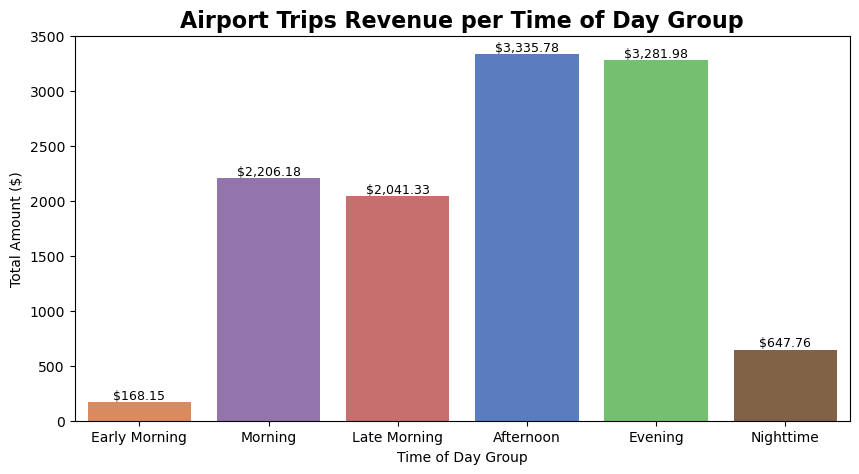

In [113]:
pltFigsize((10,5))

sns.barplot(
  data=airport_revenue_df,
  x='time_of_day_group',
  y='total_amount',
  hue='time_of_day_group',
  ci=False,
  palette='muted',
  order=timeOfDayGroupListOrder(),
)

showBarNumbers("$", 2)

pltTitle('Airport Trips Revenue per Time of Day Group')

plt.xlabel('Time of Day Group')
plt.ylabel('Total Amount ($)')

plt.show()

In [114]:
f"{round(airport_revenue_df['total_amount'].sum() / todg_revenue_df['total_amount'].sum() * 100, 2)}%"

'0.97%'

Despite common stereotypes, our airport trips are certainly not a significant source of revenue, contributing only **0.97%** of the total. However, we can see that both **Afternoon** and **Evening** airport trips has the highest total revenue compared to others. This suggests that these time-frames may align with peak hour for airport-related activities, whether it is to or from the airport.

### **How much does out of county trips contribute to revenue?**

Out of county trips can be identified by the `RatecodeID` values of **4 (Nassau or Westchester)**. Both **Nassau** and **Westchester** are counties located near the New York City.

In [115]:
out_of_county_trips_df = df[df['RatecodeID'] == 'Nassau or Westchester']
# len(out_of_county_trips_df)

In [116]:
ooc_trip_revenue_df = pd.DataFrame(out_of_county_trips_df.groupby('time_of_day_group')['total_amount'].sum())
ooc_trip_revenue_df['%Total'] = ooc_trip_revenue_df['total_amount'] / ooc_trip_revenue_df['total_amount'].sum() * 100
ooc_trip_revenue_df['%TotalPerRevenue'] = ooc_trip_revenue_df['total_amount'] / todg_revenue_df['total_amount'] * 100
ooc_trip_revenue_df

,total_amount,%Total,%TotalPerRevenue
time_of_day_group,,,
Afternoon,853.87,21.582594,0.285598
Early Morning,246.82,6.238673,0.368762
Evening,1183.81,29.922225,0.317601
Late Morning,487.32,12.317601,0.262273
Morning,501.55,12.677281,0.413795
Nighttime,682.92,17.261626,0.422491


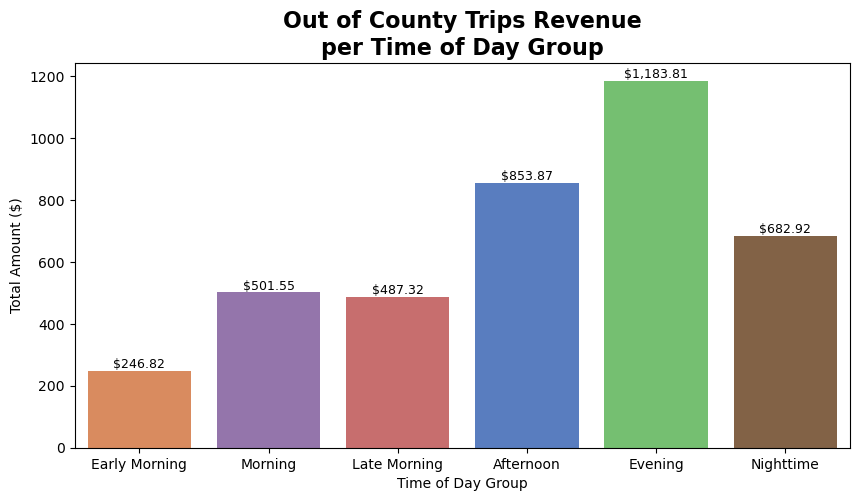

In [117]:
pltFigsize((10,5))

sns.barplot(
  data=ooc_trip_revenue_df,
  x='time_of_day_group',
  y='total_amount',
  hue='time_of_day_group',
  ci=False,
  palette='muted',
  order=timeOfDayGroupListOrder(),
)

showBarNumbers("$", 2)

pltTitle('Out of County Trips Revenue\nper Time of Day Group')

plt.xlabel('Time of Day Group')
plt.ylabel('Total Amount ($)')

plt.show()

In [118]:
f"{round(ooc_trip_revenue_df['total_amount'].sum() / todg_revenue_df['total_amount'].sum() * 100, 2)}%"

'0.33%'

While not providing as much revenue as airport trips, **Out of County Trips** certainly follow the same trend as the **Overall Revenue per Time of Day Group**. This trend signifies that the **evenings** are the time where people travel back home or perhaps for evening events. The **afternoon** trips are the second highest, coming at **$853.87**. This may indicate customers going out for business errands, lunch, or other leisure activities. Meanwhile the **Early Morning** trips are still the lowest of the bunch. This could be due to limited activity during these hours, aside from occasional airport or emergency trips.

### **How does `RatecodeID` affect revenue?**

The `RatecodeID` is a categorical column which designates the category of the trip. It has 6 unique values, which consists of:<br>
`1` = Standard rate<br>
`2` = JFK<br>
`3` = Newark<br>
`4` = Nassau or Westchester<br>
`5` = Negotiated fare<br>
`6` = Group ride

This may help us understand the fares given for each category and how we can improve it.

In [119]:
df['RatecodeID'].value_counts()

RatecodeID
Standard Rate            55758
Negotiated Fare            790
JFK                        115
Nassau or Westchester       44
Newark                      17
Name: count, dtype: int64

We can see that **Standard Rate** trips dominate the dataset, with 54k trip records. This will significantly skew the data towards the **Standard Rate** group. To counter that we will see the average trip fare and the distribution of trip fares for each group.

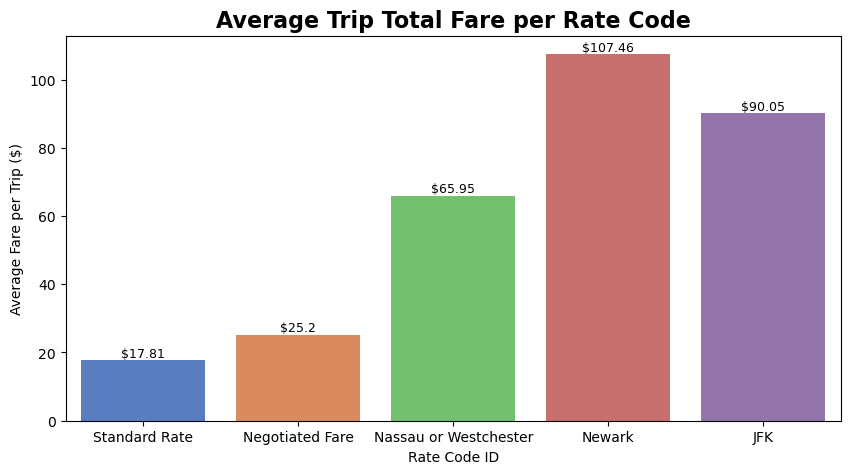

In [120]:
pltFigsize((10,5))

sns.barplot(
  data=df,
  x='RatecodeID',
  y='total_amount',
  estimator='median',
  palette='muted',
  ci=False,
)

showBarNumbers("$", 2)

pltTitle('Average Trip Total Fare per Rate Code')

plt.xlabel('Rate Code ID')
plt.ylabel('Average Fare per Trip ($)')

plt.show()

In [121]:
pd.DataFrame(df.groupby('RatecodeID')['total_amount'].median())

,total_amount
RatecodeID,
JFK,90.05
Nassau or Westchester,65.95
Negotiated Fare,25.20
Newark,107.46
Standard Rate,17.81


The graph shows us that  trips to the **Newark Liberty International Airport** has the highest average total fare per trip at a staggering **$107.46**. It is followed by trips to **Nassau** or **Westchester** and **John F. Kennedy International Airport** at **$65.95** and **$90.05** respectively. Calculated from the heart of New York City, trips to **Nassau** or **Westchester** can go up to 35 miles, which justifies the high average cost.

On the other side, **Standard Rate** trips have the lowest average fare at **$17.81**. This reflects shorter and more common trips within the city area. The **Negotiated Fare** averages at **$25.2**, which suggests discounted or pre-agreed pricing, perhaps for regular customers or specific occasions. In conclusion, trips to the city airport or to other counties are the best sources of revenue as the difference between them and the other two groups starts from 250%.

### **What makes up the overall revenue?**

We have been using the `total_amount` column to calculate revenue. As provided with the dataset, the `total_amount` column is a sum of these column:
- `fare_amount`
- `extra`
- `mta_tax`
- `tip_amount`
- `tolls_amount`
- `improvement_surcharge`
- `congestion_surcharge`

So let's see how these values contribute to our total revenue.

In [128]:
total_amount_component_df = pd.DataFrame(
  data={
    'Sum': [
      df['fare_amount'].sum(),
      df['extra'].sum(),
      df['mta_tax'].sum(),
      df['tip_amount'].sum(),
      df['tolls_amount'].sum(),
      df['improvement_surcharge'].sum(),
      df['congestion_surcharge'].sum(),
    ]
  },
  index=['Fare Amount', 'Extras', 'MTA Tax', 'Tip Amount', 'Tolls Amount', 'Improvement Surcharge', 'Congestion Surcharge']
)

total_amount_component_df['%Total'] = total_amount_component_df['Sum'] / total_amount_component_df['Sum'].sum() * 100

total_amount_component_df = total_amount_component_df.reset_index().sort_values('Sum', ascending=False)

total_amount_component_df

,index,Sum,%Total
0,Fare Amount,905217.12,74.177128
3,Tip Amount,121875.73,9.986987
5,Improvement Surcharge,54042.40,4.428451
1,Extras,52143.75,4.272868
6,Congestion Surcharge,44777.00,3.669207
2,MTA Tax,34825.50,2.853741
4,Tolls Amount,7463.84,0.611617


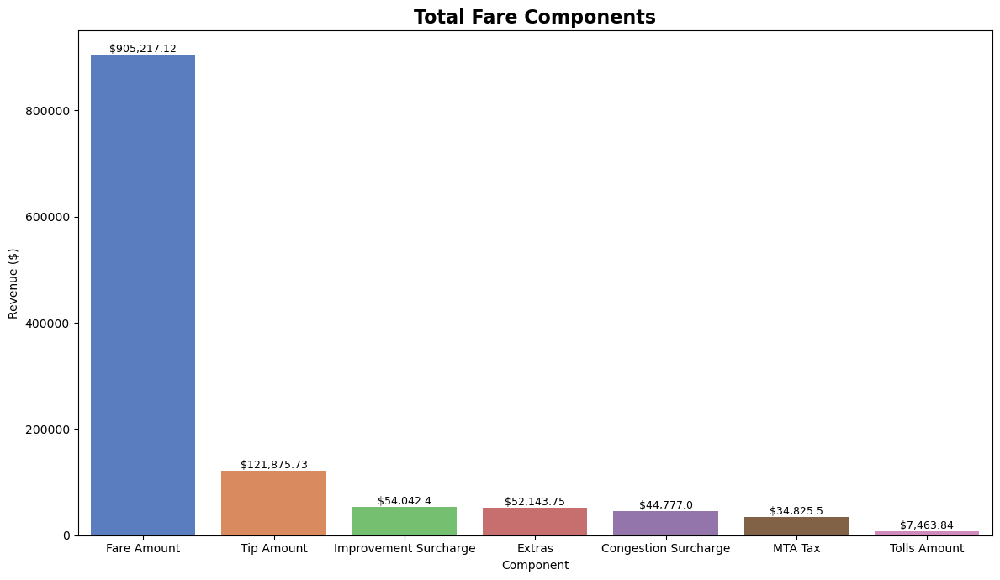

In [129]:
pltFigsize((12,7))

sns.barplot(
  data=total_amount_component_df,
  x='index',
  y='Sum',
  palette='muted',
  order=total_amount_component_df['index'],
)

pltTitle('Total Fare Components')

showBarNumbers("$", 2)

plt.xlabel('Component')
plt.ylabel('Revenue ($)')

plt.tight_layout()

plt.show()

The data reveals that **Fare Amount** contributes the most of the revenue at **$900,501.91** (**74.2%**), which is expected as it represents the base cost of the trip. **Tip Amount** follows as the second largest contributor at **$121,421.31** (**10%**), which shows how customer generosity and service quality may impact revenue. Despite being fixed or regulatory charges, `improvement_surcharge`, `congestion_surcharge`, `extra`, and `mta_tax` shows a noteable contribution to the revenue at a combined value of $183,544 (**15.1%**). Although it may seem small compared to **Fare Amount**, it is still comparable to the second largest contributor, which is **Tip Amount**. In Contrast, **Tolls Amount** is the smallest contributor, indicating that it is not a good source of income. This is most likely due to most trips not requiring tolls or perhaps highway usage.

<hr>

# **4. Conclusion and Recommendation**

## **Conclusion**

After the analysis of **NYC TLC Trip Data** for **January 2023**, we have identified several key findings:

#### ***1. City-Centric Patterns***
The majority of trips were originated from and are destined to the **city center** or **central business district**, highlighting the importance of these areas for our services. On the other hand, **residential** areas shows a significantly lower activity and even less activity the further an area is from the city center (Manhattan Island).

#### ***2. Peak hours***
**Afternoon** and **Evening** trips contributed the highest amount of trips within a one-day period. This aligns with daily commuting traffic patterns, however we can see trips during the **Morning Rush Hour** not doing as well as those in the **Afternoon** and **Evening**. This signifies that our customers are looking for convenience and comfort after a tiring day at work or after leisure activities during weekends.

#### ***3. Individualistic Behaviour***
**85.1%** of the trips were individual rides, which highlights the importance of accomodating passengers who are seeking convenience and privacy.

#### ***4. Street-Hail is King***
Street-hailing is the preferred method of using our services, with a staggering **98.8%** of the total trips being street-hailed trips. This shows that our customers expects a direct and fool-proof method to use our services. This also highlights the availability and accessibility of our services in high foot-traffic areas.

#### ***5. Simplicity Over Tangibility***
**Credit card** payments dominates the preferred payment method with **64.4%** of the trips paid by **credit cards**, likely due to its ease of use. 

#### ***6. To Tip or Not to Tip***
Contrasting with common intutions, tips have a **very weak correlation** with **Trip Distance**, **Trip Duration**, and/or **Fare Amount**. This suggests that tipping are largely dependent on individual customers tipping behaviour and/or other qualitative factors of the ride such as drivers' performance, ride quality, etc.

It is also known that **all** tips generated comes from **Credit Card** paid trips. This suggests that customers with **Cash** are stricter with unnecessary expenses such as tips.

#### ***7. High-Value Trips***
Although contributing a combined value of only **1.3%** of the total revenue, **Airport Trips** and **Out-of-County Trips** generates the most revenue per trip compared to standard trips. **Airport Trips**, generating **0.97%** of the total revenue, has an **average total fare of $96.64 per trip**, while **Out-of-County Trips** has an **average total fare of $89.92 per trip**. Though not a popular route, these trips may be worth investing into to as it generates the most revenue per trip.

#### ***8. Revenue Insights***
The **Base Fare** remains the primary contributor of revenue, generating **74%** of the total revenue. It is followed by the revenue from **Tips**, contributing only **10%**. **Surcharges**, though individually insignificant, proves to provide a consistent amount of suplementary income with a combined contribution of **15%** from the total revenue. On the other hand, **Toll Fares** provide a negligable amount of contribution of **0.6%**, certainly a predictable outcome, given that not all trips require the use of toll roads.


## **Recommendation**

#### ***Promote Weekend Trips***
Compared to Weekdays, Weekend trips only make up **25%** of the total trips. This could be due to a lot of factors we can't really control, such as potential customers preferring to use personal vehicles to travel or just preferring to stay at home. To improve trips counts on the weekend, we can introduce special promotions for fare discounts. We can also create a partnership with local recreational locations such as museums where the customers may get a fare or an entrance fee discount.

#### ***Enhance Availability in Residential Areas***
Residential areas prove to have a **very low Pickup Rate**. The causes of this is unknown, due to limited data, however one way to get more customers is by being available in their area. This will significantly reduce customer waiting time and thus we can accomodate these customers better.

#### ***Introduce Promos for Longer Trips***
We can see that the further away we go from Manhattan Island, the lower the number of trips originating and ending to these areas. This might be happening to the higher costs of travel and thus customers preferring to use an alternative means of tranporation. From the analysis we can see our trip count is very low above the **7 mile** distance mark. To improve our services attractiveness, we can provide fare discounts or promotions to these longer trips to accomodate existing customers and to attract even more customers.

#### ***Accommodate Solo Trips***
**85.1%** of trips are solo trips, meaning the customer is traveling alone. This behaviour can lead to inefficiencies when using our services primary vehile, the camry hybrid. Though the Camry provides comfort while maintaining fuel efficiency, it is probably recommended for us to invest in a more compact model to reduce overall road footprint, which may also lead to less traffic. Models such as the **Corolla Cross Hybrid** or the **Prius** may provide a more compact footprint, while improving efficiency and maintaining a degree of comfort.

#### ***Encourage the Use of Credit Cards***
We can see our customers preference of using **Credit Card** as a payment method for our services. Not only it provides convenience and simplicity, it also gives us more tips. We can see that all tips are coming from trips paid by **Credit Card**, which is rather odd. However, to capitalize on this customer behaviour we can push our customers to use **Credit Card** for trips. A plausible methods may be introducing promotions/discount when paying with Credit Card.

<hr>

# **5. Extras**

### **Save Clean Data**

In [124]:
df.to_csv('NYC TLC Trip Record - Clean.csv')